In [2]:
%load_ext autoreload
%autoreload 2
import numpy as np
import pandas as p
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import colors

from itertools import combinations
import scipy
from scipy.ndimage.filters import gaussian_filter1d
import sys
import os
import copy
atish_assay_path = 'fitness_assay_grantedits.py'
sys.path.append(os.path.dirname(os.path.expanduser(atish_assay_path)))
import fitness_assay_grantedits as atish

tools_path = '../code/tools.py'
sys.path.append(os.path.dirname(os.path.expanduser(tools_path)))
import tools

sns.set_style('white')
sns.set_style('ticks')
sns.set_color_codes()
from tools import mutant_colorset

In [3]:
name = 'noF_DoubleBC_merged+flaskswapcorrected_041819' 

merged_data = p.read_csv(f'../data/BarcodeCounts_{name}_withBCinfo.csv')



In [4]:
old_conditions = {
                  '3':['3.1','3.2','3.3'],
                  '6':['6.1','6.2','6.3'],
                  '13':['13.1','13.2','13.3'],
                  '18':['18.1','18.2','18.3'],
                  '20':['20.1','20.2','20.3'],
                  '21':['21.1','21.2','21.3'],
                  '23':['23.1','23.2','23.3']
                 }

bigbatch_conditions = {
                        '1BB_M3':['A','B','C','D'],
                        '1BB_Baffle':['E','F'],
                        '1BB_1.4%Gluc' :['G','H'],
                        '1BB_1.8%Gluc' :['I','J'],
                        '1BB_0.2MNaCl' :['K','L'],
#                         '1BB_0.5MNaCl' :['M','N'],
#                         '1BB_0.2MNaCl' :['K'], 
                        '1BB_0.2MKCl' :['O'],
                        '1BB_0.5MKCl' :['P'],
#                         '1BB_8.5uMGdA' :['Q','R'],
#                         '1BB_17uMGdA' :['S','T'],
#                         '1BB_2ugFlu' :['U','V'],
#                         '1BB_0.5ugFlu' :['W','X'],
                        '1BB_1%Raf' :['Y','Z'],
                        '1BB_0.5%Raf' :['AA','BB'],
                        '1BB_1%Gly' :['CC','DD'],
#                         '1BB_1%EtOH' :['EE','FF'],
#                         '1BB_SucRaf' :['GG'],
                      }



conditions = {**old_conditions, **bigbatch_conditions}

just_reps = [rep for reps in conditions.values() for rep in reps]

In [5]:
full_neutral_list = [17615,18486,42040,45014,58284,63611,73731,74185,80465,94896
,120600,125697,132511,134852,135750,190551,228237,238783,255561,298344
,308537,316954,317346,335717,411685,454359,469053] 

### from previous list but never has fitness above 3.5% (per gen) in any of 5000bc experiments
supergood_neutral = [17615, 24362, 42040, 71926, 72939, 73802, 80465, 109476, 113483, 
                     134852, 135750, 238783, 263665, 276406, 316954, 335717, 454359] 

### pulled from supergood list and spiked into 1BigBatch experiments
neutral_spikes = [17615,24362,42040,71926,73802,109476,113483,134852,263665,316954]

# neutrals = full_neutral_list
neutrals = list(np.unique(full_neutral_list+supergood_neutral+neutral_spikes))



In [6]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data = data.replace([np.inf, -np.inf], np.nan)
data = data.sort_values('barcode')


fitnesses = {}


for counter,rep in enumerate(just_reps):

    timepoints = []
    these_times = []
    if rep in tools.flatten([i for i in old_conditions.values()]):
        e,r = rep.split('.')
#         if e in ['13','15']:
#             timepoints.append(0)
#             these_times.append('13-0_pool')
#         else:
#             if e+'-0' in data.columns:
#                 timepoints.append(0)
#                 these_times.append(e+'-0')

        for t in range(1,5):
            if e+'-'+str(t)+'-'+r in data.columns:
                timepoints.append(t)
                these_times.append(e+'-'+str(t)+'-'+r)

    if rep in tools.flatten([i for i in bigbatch_conditions.values()]):
        for i in range(5):
            if rep+str(i) in data.columns:
                these_times.append(rep+str(i))
                timepoints.append(i)

    log_freqs = [data[time].values/np.nansum(data[time].values) for time in these_times]
    log_freqs = np.log(np.asarray(log_freqs).swapaxes(0,1))
    
    fitnesses[rep] = np.diff(log_freqs)

# plt.savefig(f'Alltrajectories_old+1bb_swapscorrected_reshape.pdf',bbox_inches='tight')

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: divide by zero encountered in log
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/lib/function_base.py:1946: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])


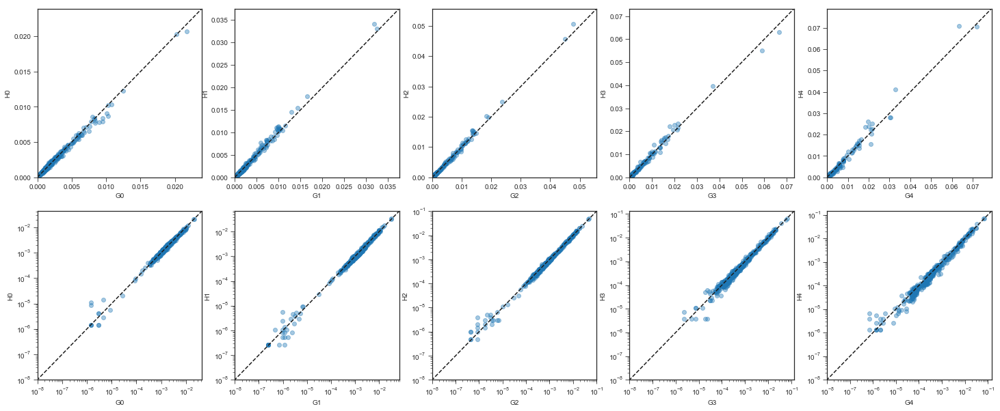

In [77]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]

x_rep = 'G'
y_rep = 'H'
timepoints =5
plt.figure(figsize=(5*timepoints,5*2))
for t in range(5):


    x_tp = x_rep+str(t)
    y_tp = y_rep+str(t)
    
    x_data = data[x_tp].values/np.nansum(data[x_tp].values)
    y_data = data[y_tp].values/np.nansum(data[y_tp].values)
    plt.subplot(2,timepoints,t+1)
    plt.scatter(x_data,y_data,alpha=0.4)
    bigmax = max([max(x_data),max(y_data)])
    plt.plot([0,bigmax*1.1],[0,bigmax*1.1],'k--')
    plt.xlim(0,bigmax*1.1)
    plt.ylim(0,bigmax*1.1)

    plt.xlabel(x_tp)
    plt.ylabel(y_tp)

    plt.subplot(2,timepoints,5+t+1)
    plt.scatter(x_data,y_data,alpha=0.4)
    bigmax = max([max(x_data),max(y_data)])
    # bigmin = min([min(x_data),min(y_data)])
    plt.plot([0,bigmax*2],[0,bigmax*2],'k--')
    plt.xlim(10**-8,bigmax*2)
    plt.ylim(10**-8,bigmax*2)
    plt.yscale('log')
    plt.xscale('log')

    plt.xlabel(x_tp)
    plt.ylabel(y_tp)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: divide by zero encountered in log
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: invalid value encountered in subtract
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:49: RuntimeWarning: divide by zero encountered in log
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:49: RuntimeWarning: invalid value encountered in subtract
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  m

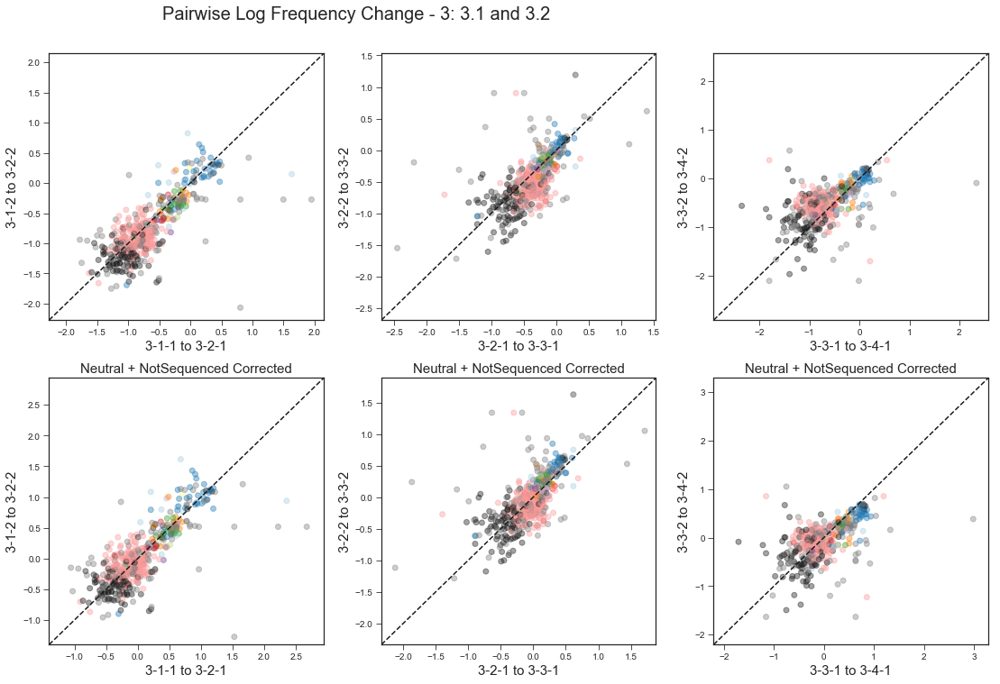

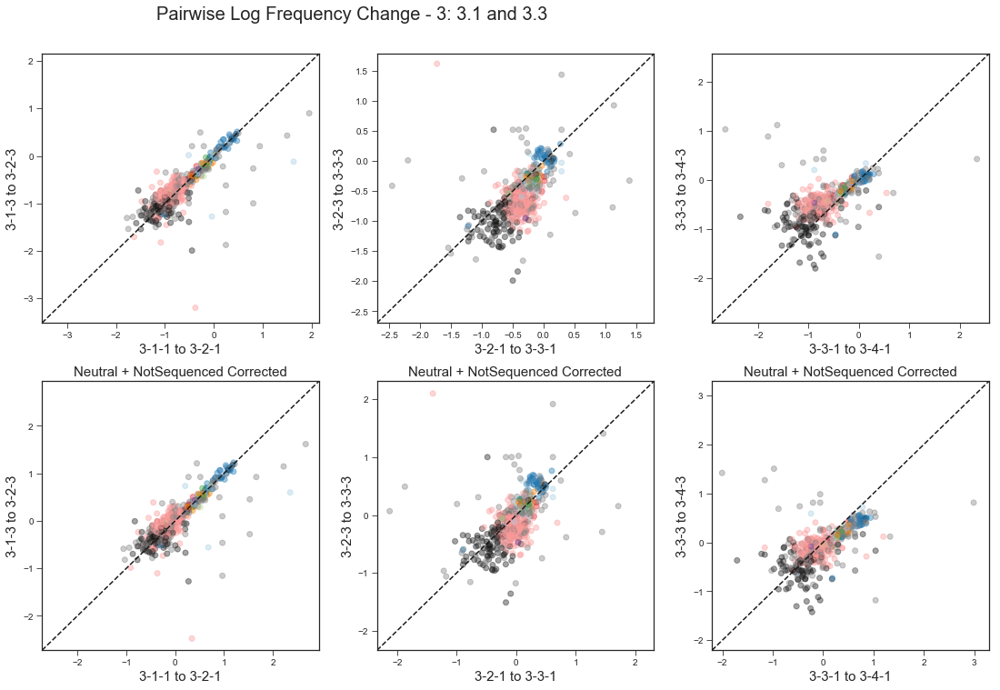

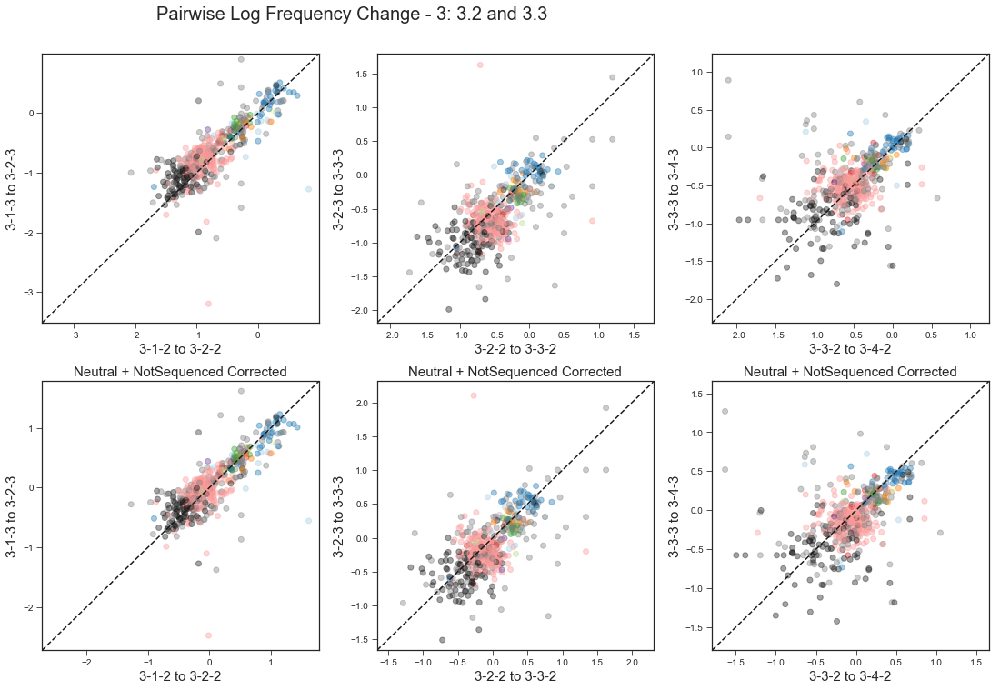

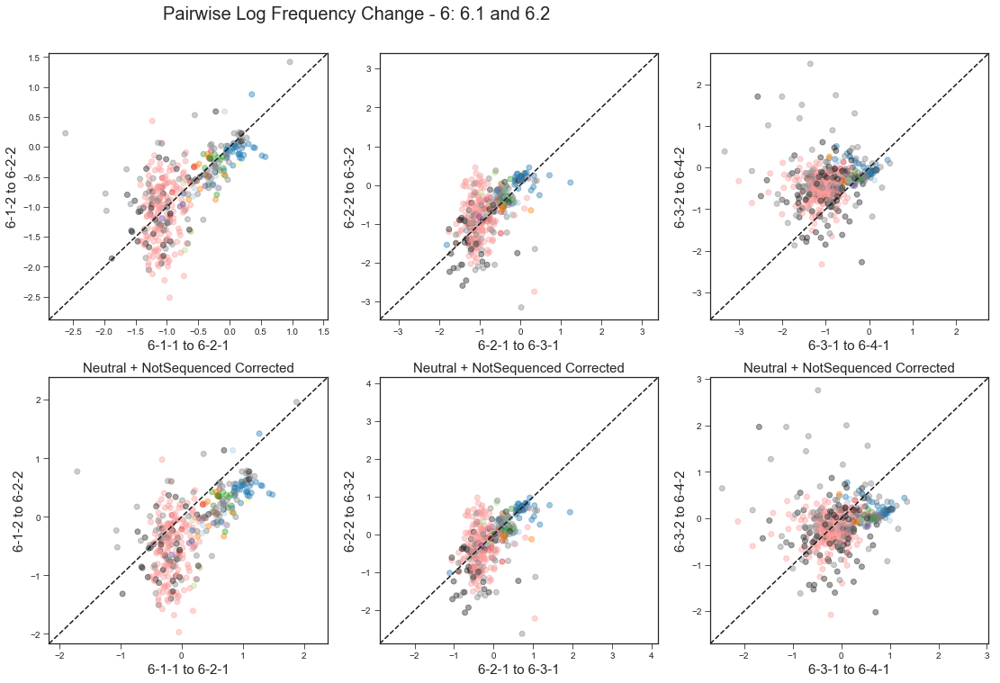

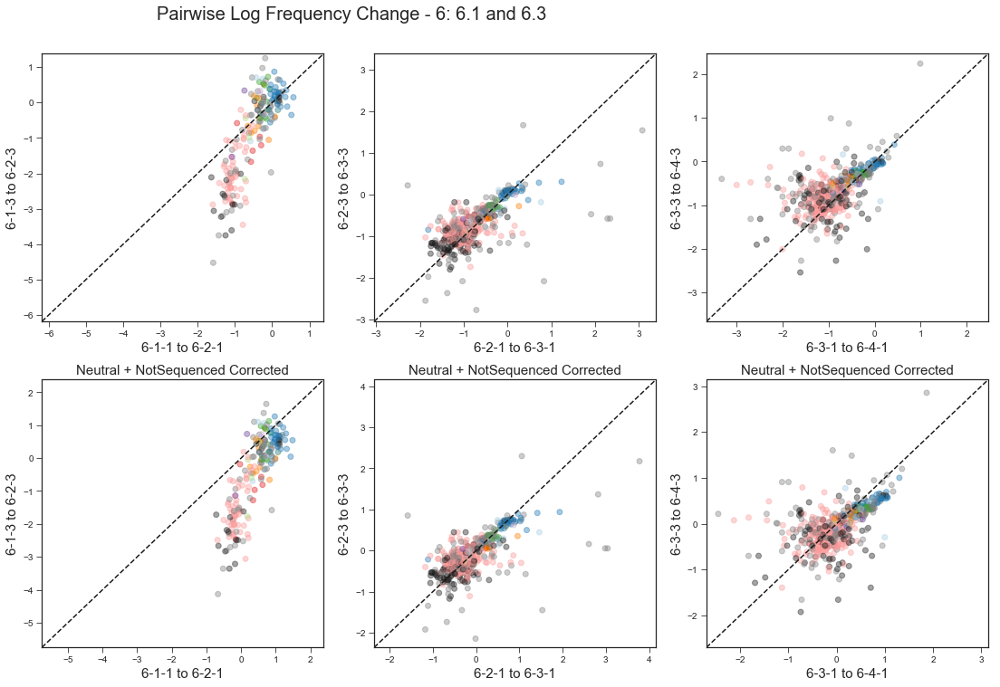

...

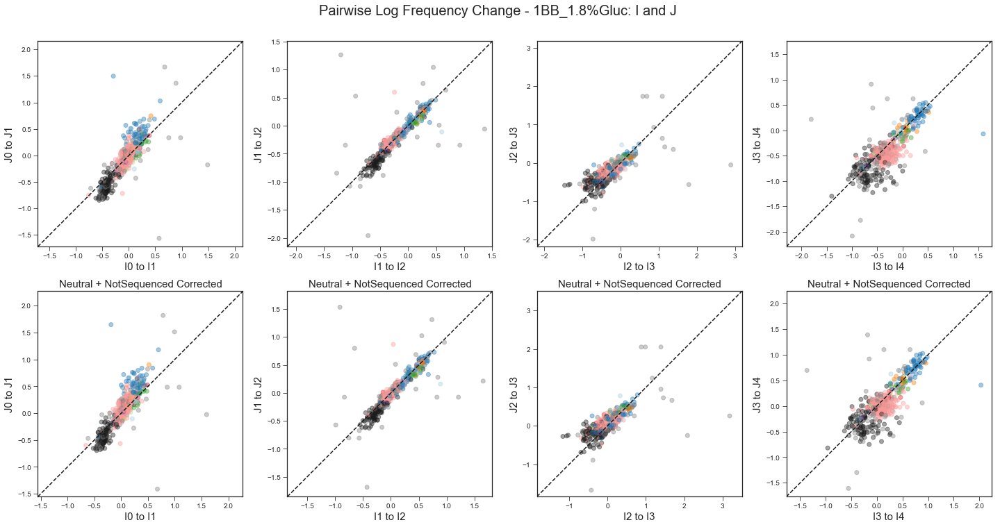

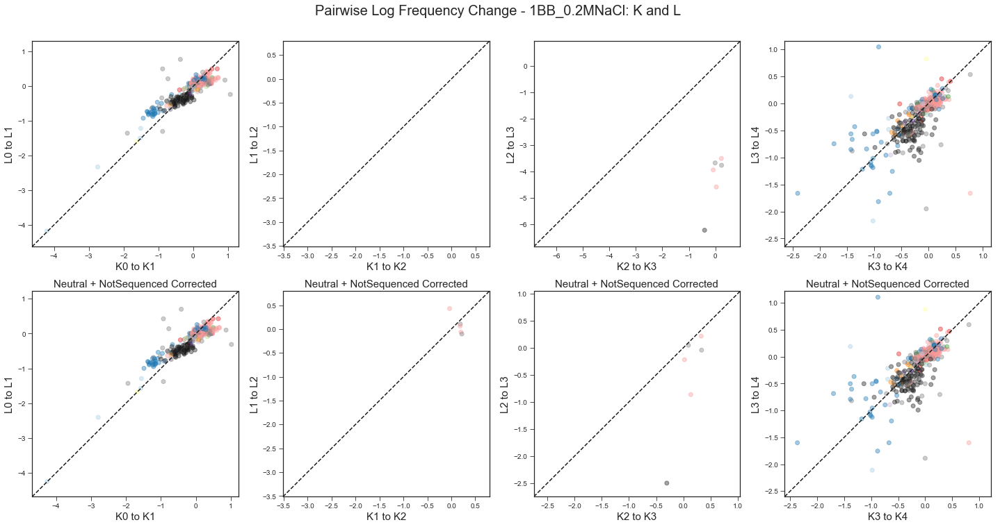

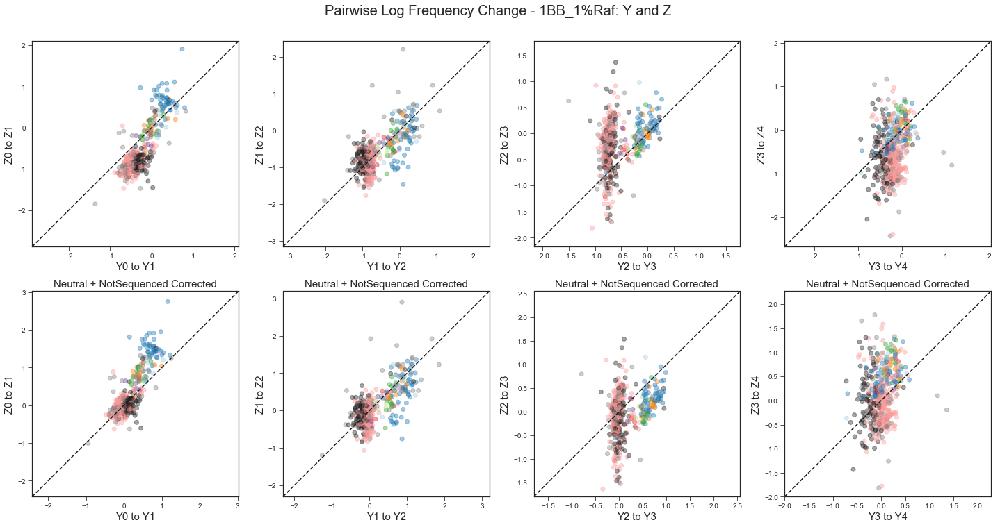

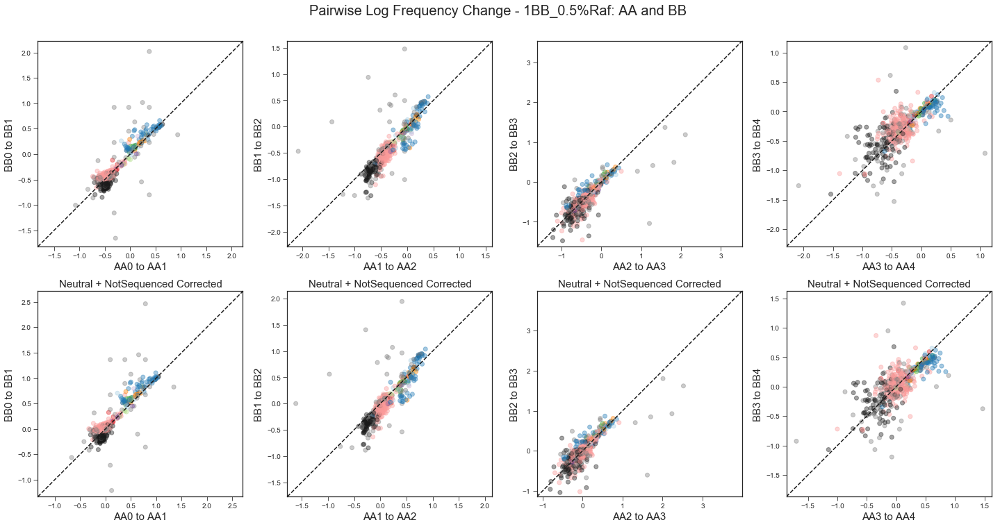

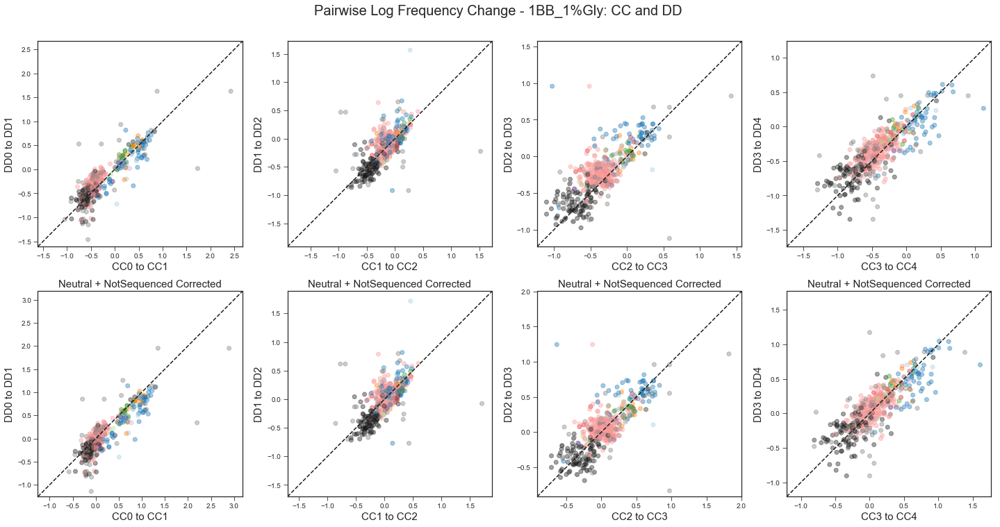

In [77]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data = data.replace([np.inf, -np.inf], np.nan)
data= data.sort_values('barcode')

for condition in conditions:
    if condition in bigbatch_conditions:
        reps = bigbatch_conditions[condition]
        start = 0
    else:
        reps = old_conditions[condition]
        start = 1
    
    for x_rep,y_rep in combinations(reps,2):
#     x_rep = 'E'
#     y_rep = 'F'
       
        timepoints =5
        
#         timepoints = len

    

        neutrals = [bc for bc in data['barcode'].values if bc in neutrals]
#         neutral_locs = np.where(np.isin(data['barcode'].values,neutrals))[0]
        neutral_locs = np.where(np.isin(data['barcode'].values,neutrals+list(data[data['class'].isin(['NotSequenced'])]['barcode'].values)))[0]


        mutant_colors = [mutant_colorset[gene] for gene in data['gene'].values]

        plt.figure(figsize=(5*timepoints,5*2))
        for t in range(start,timepoints-1):

            if condition in bigbatch_conditions:
                x_tp_first = x_rep+str(t)
                x_tp_second = x_rep+str(t+1)
                y_tp_first = y_rep+str(t)
                y_tp_second = y_rep+str(t+1)
            else:
                e,r = x_rep.split('.')
                x_tp_first =  e+'-'+str(t)+'-'+r
                x_tp_second =  e+'-'+str(t+1)+'-'+r
                e,r = y_rep.split('.')
                y_tp_first =  e+'-'+str(t)+'-'+r
                y_tp_second =  e+'-'+str(t+1)+'-'+r
                

            x_data =  np.log(data[x_tp_second].values/np.nansum(data[x_tp_second].values))-np.log(data[x_tp_first].values/np.nansum(data[x_tp_first].values))
            y_data =  np.log(data[y_tp_second].values/np.nansum(data[y_tp_second].values))-np.log(data[y_tp_first].values/np.nansum(data[y_tp_first].values))
            x_data[x_data == np.inf] = np.nan
            x_data[x_data == -np.inf] = np.nan
            y_data[y_data == np.inf] = np.nan
            y_data[y_data == -np.inf] = np.nan

            plt.subplot(2,timepoints,t+1)
            plt.scatter(x_data,y_data,alpha=0.4,color=mutant_colors)
            bigmax = max([max(x_data),max(y_data)])
            bigmin = min([np.nanmin(x_data),np.nanmin(y_data)])
            plt.plot([bigmin*1.1,bigmax*1.1],[bigmin*1.1,bigmax*1.1],'k--')
            plt.xlim(bigmin*1.1,bigmax*1.1)
            plt.ylim(bigmin*1.1,bigmax*1.1)
            plt.xlabel(x_tp_first +' to '+ x_tp_second,fontsize=15)
            plt.ylabel(y_tp_first +' to '+ y_tp_second,fontsize=15)

        #     neutrals_x = np.log(np.nansum((data[x_tp_first].values/np.nansum(data[x_tp_first].values))[neutral_locs]))-np.log(np.nansum((data[x_tp_second].values/np.nansum(data[x_tp_second].values))[neutral_locs]))
        #     neutrals_y = np.log(np.nansum((data[y_tp_first].values/np.nansum(data[y_tp_first].values))[neutral_locs]))-np.log(np.nansum((data[y_tp_second].values/np.nansum(data[y_tp_second].values))[neutral_locs]))
        #     neutral_corrected_x = x_data - neutrals_x
        #     neutral_corrected_y = y_data - neutrals_y

            neutral_corrected_x = x_data - np.nanmedian(x_data[neutral_locs])
            neutral_corrected_y = y_data - np.nanmedian(y_data[neutral_locs])

            plt.subplot(2,timepoints,5+t+1)
            plt.scatter(neutral_corrected_x,neutral_corrected_y,alpha=0.4,color=mutant_colors)
            bigmax = max([max(neutral_corrected_x),max(neutral_corrected_y)])
            bigmin = min([np.nanmin(neutral_corrected_x),np.nanmin(neutral_corrected_y)])
            plt.plot([bigmin*1.1,bigmax*1.1],[bigmin*1.1,bigmax*1.1],'k--')
            plt.xlim(bigmin*1.1,bigmax*1.1)
            plt.ylim(bigmin*1.1,bigmax*1.1)
            plt.xlabel(x_tp_first +' to '+ x_tp_second,fontsize=15)
            plt.ylabel(y_tp_first +' to '+ y_tp_second,fontsize=15)
#             plt.title('Neutral Corrected',fontsize=15)
            plt.title('Neutral + NotSequenced Corrected',fontsize=15)
        plt.tight_layout()
        plt.suptitle(f'Pairwise Log Frequency Change - {condition}: {x_rep} and {y_rep}',fontsize=20,x=0.4,y=1.05)
        plt.savefig(f'pairwise_log_frequency_change_{x_rep}_{y_rep}_NS+neutralcorrection_median.pdf',bbox_inches='tight')


# x_data = np.log(data['A1'].values/np.nansum(data['A1'].values))-np.log(data['A0'].values/np.nansum(data['A0'].values))
# y_data = np.log(data['B1'].values/np.nansum(data['B1'].values))-np.log(data['B0'].values/np.nansum(data['B0'].values))

# plt.scatter(x_data,y_data,alpha=0.4)
# plt.plot([-1.0,1.5],[-1.0,1.5],'k--')

In [120]:
np.nanmean(x_data[neutral_locs])
# np.nanmean(y_data[neutral_locs])

-0.8300646458198448

In [7]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data = data.sort_values('barcode')


fitnesses = {}


for counter,rep in enumerate(just_reps):

    timepoints = []
    these_times = []
    if rep in tools.flatten([i for i in old_conditions.values()]):
        e,r = rep.split('.')
#         if e in ['13','15']:
#             timepoints.append(0)
#             these_times.append('13-0_pool')
#         else:
#             if e+'-0' in data.columns:
#                 timepoints.append(0)
#                 these_times.append(e+'-0')

        for t in range(1,5):
            if e+'-'+str(t)+'-'+r in data.columns:
                timepoints.append(t)
                these_times.append(e+'-'+str(t)+'-'+r)

    if rep in tools.flatten([i for i in bigbatch_conditions.values()]):
        for i in range(5):
            if rep+str(i) in data.columns:
                these_times.append(rep+str(i))
                timepoints.append(i)

    log_freqs = [data[time].values/np.nansum(data[time].values) for time in these_times]
    log_freqs = np.log(np.asarray(log_freqs).swapaxes(0,1))
    
    fitnesses[rep] = np.diff(log_freqs)

# plt.savefig(f'Alltrajectories_old+1bb_swapscorrected_reshape.pdf',bbox_inches='tight')

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:35: RuntimeWarning: divide by zero encountered in log
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/lib/function_base.py:1946: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])


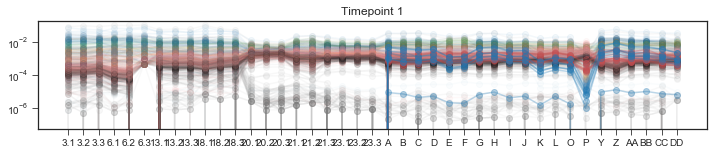

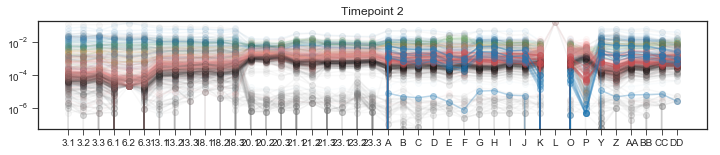

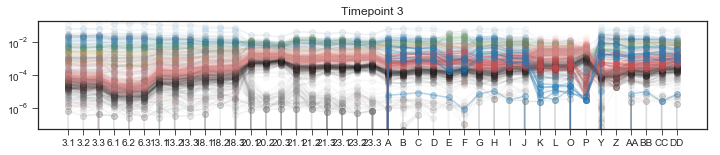

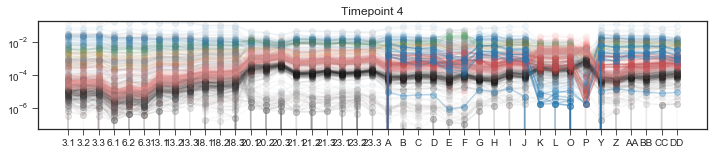

In [29]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data = data.sort_values('barcode')

genes = data['gene'].values
fitnesses = {}
for t in range(1,5):
    plt.figure(figsize=(12,2))
#     this_t_reps = []
    these_times = []
    for counter,rep in enumerate(just_reps):


        if rep in tools.flatten([i for i in old_conditions.values()]):
            e,r = rep.split('.')
            if e+'-'+str(t)+'-'+r in data.columns:
                these_times.append(e+'-'+str(t)+'-'+r)

        if rep in tools.flatten([i for i in bigbatch_conditions.values()]):
            if rep+str(t) in data.columns:
                these_times.append(rep+str(t))

    freqs = [data[time].values/np.nansum(data[time].values) for time in these_times]
    freqs = np.asarray(freqs)
    for bc in range(len(data['barcode'].values)):
        if data['barcode'].values[bc] > 9000100:
            plt.plot(range(len(these_times)),freqs[:,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.3)
        elif data['barcode'].values[bc] > 9000000:
            plt.plot(range(len(these_times)),freqs[:,bc],'o-',color='r',alpha=0.3)
        else:
            plt.plot(range(len(these_times)),freqs[:,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
#         plt.plot(range(len(these_times)),freqs[bc,:],)
    plt.yscale('log')    
    plt.xticks(range(len(these_times)),just_reps)
    plt.ylim(5*10**-8,2*10**-1)
    plt.title(f'Timepoint {t}')

    plt.savefig(f'frequencies_t{t}_logscale_fixedylim.pdf',bbox_inches='tight')

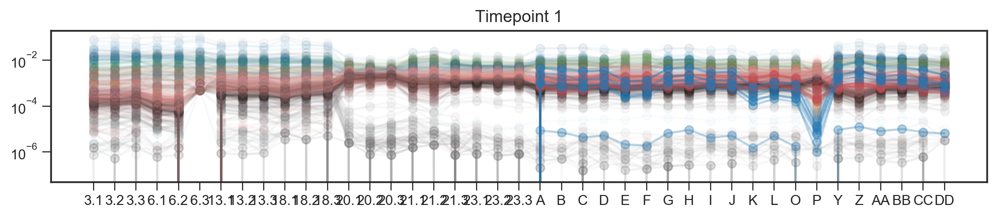

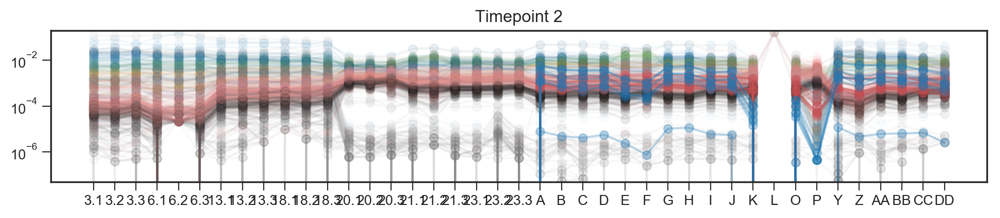

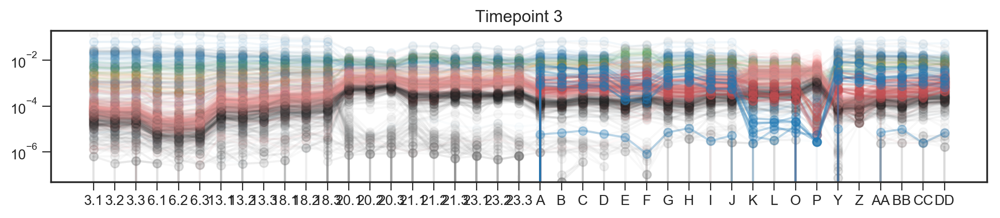

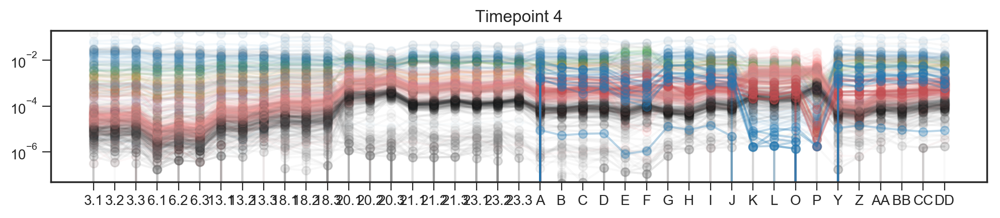

In [32]:
import imageio

data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data = data.sort_values('barcode')

genes = data['gene'].values
fitnesses = {}

def plot(t):
    fig = plt.figure(figsize=(12,2),dpi=200)
#     this_t_reps = []
    these_times = []
    for counter,rep in enumerate(just_reps):


        if rep in tools.flatten([i for i in old_conditions.values()]):
            e,r = rep.split('.')
            if e+'-'+str(t)+'-'+r in data.columns:
                these_times.append(e+'-'+str(t)+'-'+r)

        if rep in tools.flatten([i for i in bigbatch_conditions.values()]):
            if rep+str(t) in data.columns:
                these_times.append(rep+str(t))

    freqs = [data[time].values/np.nansum(data[time].values) for time in these_times]
    freqs = np.asarray(freqs)
    for bc in range(len(data['barcode'].values)):
        if data['barcode'].values[bc] > 9000100:
            plt.plot(range(len(these_times)),freqs[:,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.3)
        elif data['barcode'].values[bc] > 9000000:
            plt.plot(range(len(these_times)),freqs[:,bc],'o-',color='r',alpha=0.3)
        else:
            plt.plot(range(len(these_times)),freqs[:,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
#         plt.plot(range(len(these_times)),freqs[bc,:],)
    plt.yscale('log')    
    plt.xticks(range(len(these_times)),just_reps)
    plt.ylim(5*10**-8,2*10**-1)
    plt.title(f'Timepoint {t}')
    fig.canvas.draw()
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    return image


imageio.mimsave('./frequencies.gif', [plot(t) for t in range(1,5)], fps=1)
    
#     plt.savefig(f'frequencies_t{t}_logscale_fixedylim.pdf',bbox_inches='tight')

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: Mean of empty slice
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:25: RuntimeWarning: Mean of empty slice


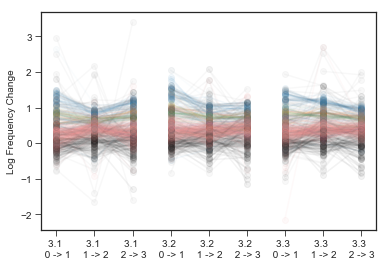

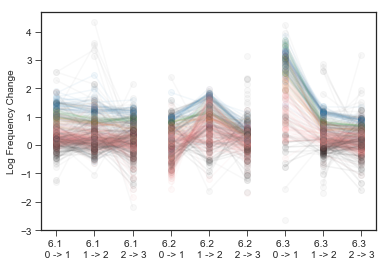

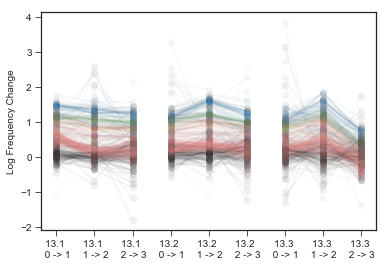

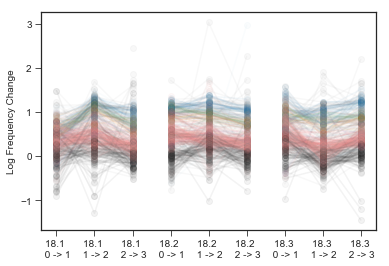

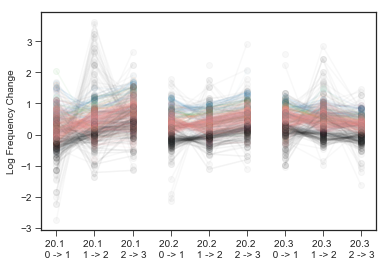

...

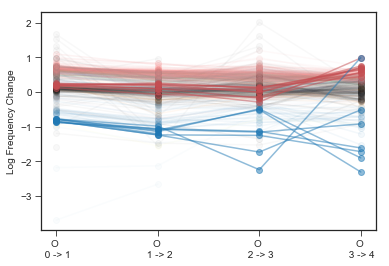

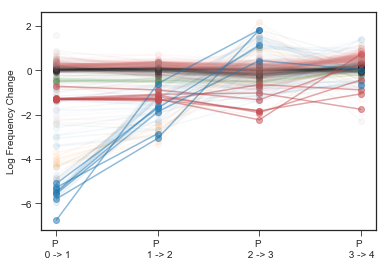

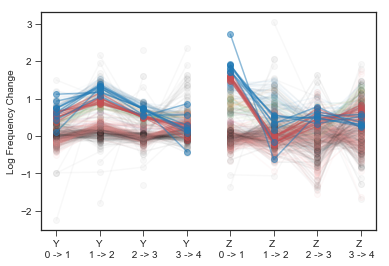

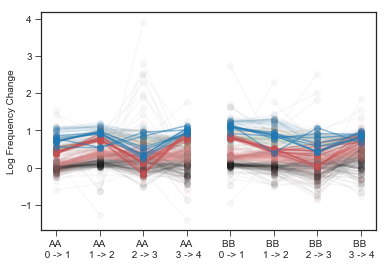

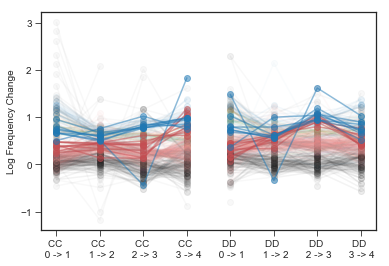

In [77]:

data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data= data.sort_values('barcode')
data = data.replace([np.inf, -np.inf], np.nan)

genes = data['gene'].values
neutral_locs = np.where(np.isin(data['barcode'].values,neutrals))[0]

for condition in conditions:
    mean_changes = []
    
    plt.figure()
    if condition in bigbatch_conditions:
        reps = bigbatch_conditions[condition]
    else:
        reps = old_conditions[condition]
    time_names = []
    time_places = []
    for i,rep in enumerate(reps):
        these_fitnesses = fitnesses[rep]
        these_fitnesses[these_fitnesses == np.inf] = np.nan
        these_fitnesses[these_fitnesses == -np.inf] = np.nan
        
        mean_neutral_deviation = np.nanmean(these_fitnesses[neutral_locs],axis=0)
#         print(condition,t,mean_neutral_deviation)
        these_fitnesses = these_fitnesses - mean_neutral_deviation
#         for t in range(these_fitnesses.shape[1]):
            
#             x_val = len(reps)*i+t
        these_times = [(these_fitnesses.shape[1])*i + t for t in range(these_fitnesses.shape[1])] 
        time_places = time_places + these_times
        time_names = time_names + [f'{rep} \n {t} -> {t+1}' for t in range(these_fitnesses.shape[1])] 
        for bc in range(these_fitnesses.shape[0]):
            if data['barcode'].values[bc] > 9000100:
                plt.plot(these_times,these_fitnesses[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
            elif data['barcode'].values[bc] > 9000000:
                plt.plot(these_times,these_fitnesses[bc],'o-',color='r',alpha=0.5)
            else:
                plt.plot(these_times,these_fitnesses[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
                
        mean_changes.append(np.nanmean(these_fitnesses,axis=1))
    
#     plt.ylim(-.002,0.01)   
    plt.ylabel('Log Frequency Change')
    plt.xticks(time_places,time_names)
    plt.savefig(f'log-frequency_fitness_plots_{condition}_neutralcorrection.pdf',bbox_inches='tight')
    
#     plt.figure()
#     for i,rep in enumerate(reps):
#         for bc in range(len(mean_changes[i])):
#             plt.plot(tools.jitter_point(i),mean_changes[i][bc])
#     plt.xticks(range(len(reps)),reps)
#     plt.ylabel('Mean Log Frequency Change')
#     plt.savefig(f'log-frequency_fitness_plots_{condition}_mean.pdf',bbox_inches='tight')
    
        

In [80]:
neutral_locs = np.where(np.isin(data['barcode'].values,neutrals))[0]


0.0019227610564968925
0.0019227610564968925
0.0019227610564968925
0.0019227610564968925


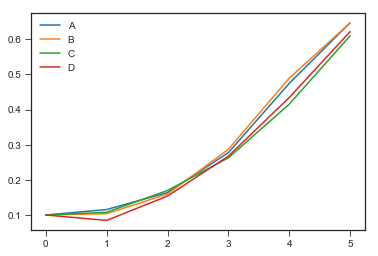

In [86]:
for rep in ['A','B','C','D']:
# for rep in ['E','F']: 
    
    
    these_freqs = data[['Tneg']+[rep+str(t) for t in range(5)]].values
    these_freqs = these_freqs/np.sum(these_freqs,axis=0)
    neutral_freqs = np.sum(these_freqs[neutral_locs,:],axis=0)
    
    q = neutral_freqs[0]*0.1/(1-0.1)
    print(q)
    bc_frac = [0.1]
    for t in range(1,len(neutral_freqs)):
        bc_frac.append(q/(q+neutral_freqs[t]))
    
    plt.plot([i for i in bc_frac],label=rep)
plt.legend()

0.0004193389181417857
0.0004193389181417857
0.0004193389181417857


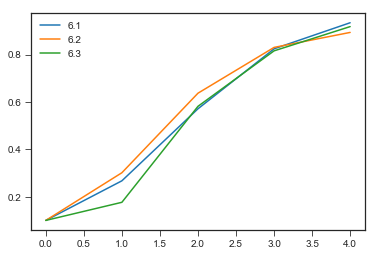

In [84]:
for rep in ['6.1','6.2','6.3']: 
    e,r = rep.split('.')
    
    these_freqs = data[[e+'-0']+[e+'-'+str(t)+'-'+r for t in range(1,5)]].values
    these_freqs = these_freqs/np.sum(these_freqs,axis=0)
    neutral_freqs = np.sum(these_freqs[neutral_locs,:],axis=0)
    
    q = neutral_freqs[0]*0.1/(1-0.1)
    print(q)
    bc_frac = [0.1]
    for t in range(1,len(neutral_freqs)):
        bc_frac.append(q/(q+neutral_freqs[t]))
    
    plt.plot([i for i in bc_frac],label=rep)
plt.legend()

In [33]:
these_freqs = data[['A'+str(t) for t in range(5)]].values
these_freqs = these_freqs/np.sum(these_freqs,axis=0)
np.sum(these_freqs[neutral_locs,:],axis=0)

array([0.01472121, 0.0098211 , 0.00500561, 0.0021285 , 0.00104926])

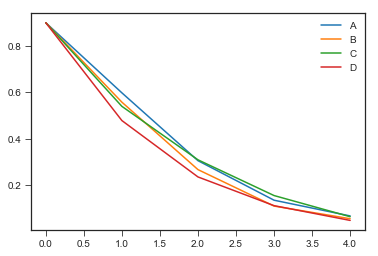

In [19]:
for rep in ['A','B','C','D']:
    
    q = 0.9
    
    these_freqs = data[[rep+str(t) for t in range(5)]]
    neutral_freqs = np.sum(these_freqs[neutral_locs,:],axis=0)
    
    these_fitnesses = fitnesses[rep]
    these_fitnesses[these_fitnesses == np.inf] = np.nan
    these_fitnesses[these_fitnesses == -np.inf] = np.nan

    mean_neutral_deviation = np.nanmean(these_fitnesses[neutral_locs],axis=0)
    l = [0.9]
    for i in range(len(mean_neutral_deviation)):
        l.append(l[i]*np.exp(mean_neutral_deviation[i]))
    plt.plot([i for i in l],label=rep)
plt.legend()

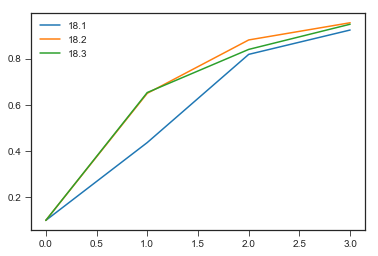

In [27]:
for rep in ['18.1','18.2','18.3']:
    these_fitnesses = fitnesses[rep]
    these_fitnesses[these_fitnesses == np.inf] = np.nan
    these_fitnesses[these_fitnesses == -np.inf] = np.nan

    mean_neutral_deviation = np.nanmean(these_fitnesses[neutral_locs],axis=0)
    l = [0.9]
    for i in range(len(mean_neutral_deviation)):
        l.append(l[i]*np.exp(mean_neutral_deviation[i]))
    plt.plot([1-i for i in l],label=rep)
plt.legend()

KeyboardInterrupt: 

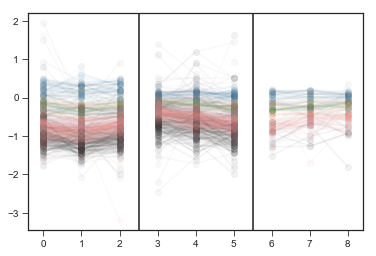

In [25]:
genes = data['gene'].values

for condition in conditions:
# for condition in ['1BB_M3']:
    plt.figure()
    if condition in bigbatch_conditions:
        reps = bigbatch_conditions[condition]
    else:
        reps = old_conditions[condition]
    time_names = []
    time_places = []
    
    for t in range(fitnesses[reps[0]].shape[1]):
        these_t_reps = np.asarray([fitnesses[rep][:,t] for rep in reps])
        these_t_reps = these_t_reps.swapaxes(0,1)

        these_times = [len(reps)*t + r for r in range(len(reps))] 
        time_places = time_places + these_times
        time_names = time_names + [f'{rep}\n{t}' for rep in reps] 
        for bc in range(these_t_reps.shape[0]):
            if data['barcode'].values[bc] > 9000100:
                plt.plot(these_times,these_t_reps[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
            elif data['barcode'].values[bc] > 9000000:
                plt.plot(these_times,these_t_reps[bc],'o-',color='r',alpha=0.5)
            else:
                plt.plot(these_times,these_t_reps[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
        if t != fitnesses[reps[0]].shape[1]-1:
            plt.axvline(x=len(reps)*(t+1)-0.5,color='k') 
    plt.title(f'{condition} Log Frequency Change By Timepoint')
    plt.ylabel('Log Frequency Change')
    plt.xticks(time_places,time_names)
    plt.savefig(f'log-frequency_fitness_plots_{condition}_bytime.pdf',bbox_inches='tight')
    
        

In [32]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data = data.replace([np.inf, -np.inf], np.nan)

neutral_locs = np.where(np.isin(data['barcode'].values,neutrals))[0]

neutral_locs

array([288, 350, 465, 520, 521, 522, 523, 524, 525, 526, 527, 528, 529])

3 0 [-0.71565705 -0.85801019 -0.77787642]
3 1 [-0.46853896 -0.51993067 -0.64025323]
3 2 [-0.70943431 -0.61846817 -0.52315941]
6 0 [-0.90574026 -0.69405571 -1.05173822]
6 1 [-0.746472   -0.77786952 -0.77567262]
6 2 [-0.89249661 -0.34022871 -0.68289515]
13 0 [-0.71417848 -0.5337797  -0.52223443]
13 1 [-0.75182776 -0.86876533 -0.89193985]
13 2 [-0.79974421 -0.82789336 -0.53199721]
18 0 [-0.20098368 -0.55036476 -0.47200916]
18 1 [-0.62539369 -0.58510653 -0.54114072]
18 2 [-0.54391397 -0.63713928 -0.69012539]
20 0 [-0.44589138 -0.39252287 -0.35049405]
20 1 [-0.17741361 -0.32530558 -0.12544655]
20 2 [-0.57688048 -0.47110266 -0.41017782]
21 0 [-0.44299584 -0.39789914 -0.3696451 ]
21 1 [-0.16107742 -0.47706852 -0.28738612]
21 2 [-0.55746708 -0.4012755  -0.41945035]
23 0 [-0.49010245 -0.19464614 -0.26372989]
23 1 [-0.48231957 -0.56263818 -0.43886899]
23 2 [-0.29526189 -0.3688325  -0.37139953]
1BB_M3 0 [-0.23537811 -0.34793315 -0.37755021 -0.36384769]
1BB_M3 1 [-0.4748335  -0.41170933 -0.4843569

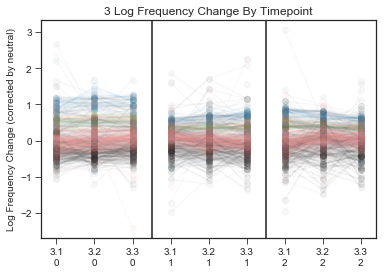

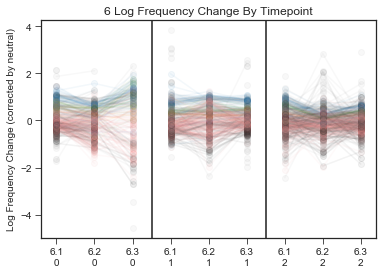

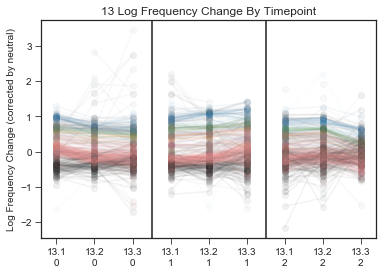

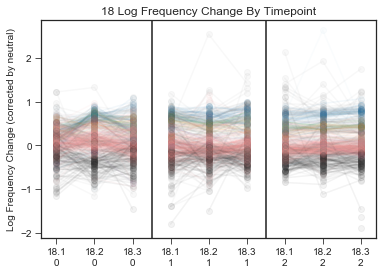

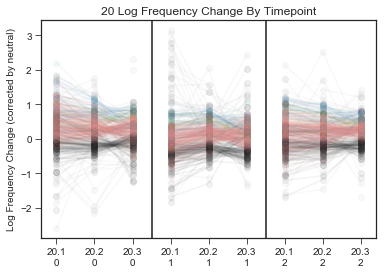

...

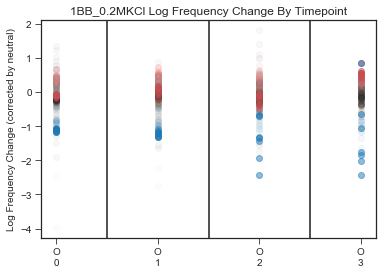

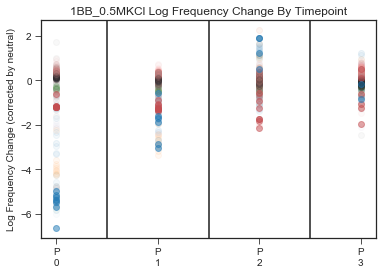

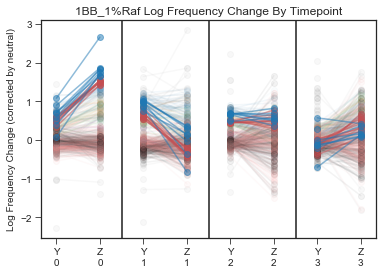

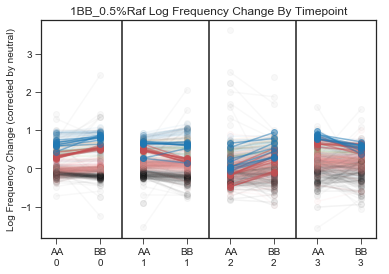

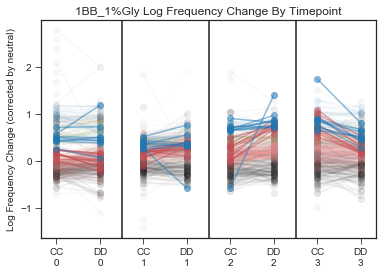

In [74]:
full_neutral_list = [17615,18486,42040,45014,58284,63611,73731,74185,80465,94896
,120600,125697,132511,134852,135750,190551,228237,238783,255561,298344
,308537,316954,317346,335717,411685,454359,469053] 

### from previous list but never has fitness above 3.5% (per gen) in any of 5000bc experiments
supergood_neutral = [17615, 24362, 42040, 71926, 72939, 73802, 80465, 109476, 113483, 
                     134852, 135750, 238783, 263665, 276406, 316954, 335717, 454359] 

### pulled from supergood list and spiked into 1BigBatch experiments
neutral_spikes = [17615,24362,42040,71926,73802,109476,113483,134852,263665,316954]

# neutrals = full_neutral_list
neutrals = list(np.unique(full_neutral_list+supergood_neutral+neutral_spikes))

neutrals = [bc for bc in data['barcode'].values if bc in neutrals]

# neutral_locs = np.where(np.isin(data['barcode'].values,neutrals))[0]
neutral_locs = np.where(np.isin(data['barcode'].values,data[data['class'].isin(['other','NotSequenced'])]['barcode'].values))[0]

# fitnesses = fitnesses.replace([np.inf, -np.inf], np.nan)
genes = data['gene'].values

for condition in conditions:
# for condition in ['1BB_M3']:
    plt.figure()
    if condition in bigbatch_conditions:
        reps = bigbatch_conditions[condition]
    else:
        reps = old_conditions[condition]
    time_names = []
    time_places = []
    
    for t in range(fitnesses[reps[0]].shape[1]):
        these_t_reps = np.asarray([fitnesses[rep][:,t] for rep in reps])
        these_t_reps[these_t_reps == np.inf] = np.nan
        these_t_reps[these_t_reps == -np.inf] = np.nan
        these_t_reps = these_t_reps.swapaxes(0,1)

        these_times = [len(reps)*t + r for r in range(len(reps))] 
        time_places = time_places + these_times
        time_names = time_names + [f'{rep}\n{t}' for rep in reps]
        
        mean_neutral_deviation = np.nanmean(these_t_reps[neutral_locs],axis=0)
        print(condition,t,mean_neutral_deviation)
        these_t_reps = these_t_reps - mean_neutral_deviation
        
        for bc in range(these_t_reps.shape[0]):
            if data['barcode'].values[bc] > 9000100:
                plt.plot(these_times,these_t_reps[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
            elif data['barcode'].values[bc] > 9000000:
                plt.plot(these_times,these_t_reps[bc],'o-',color='r',alpha=0.5)
            else:
                plt.plot(these_times,these_t_reps[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
        if t != fitnesses[reps[0]].shape[1]-1:
            plt.axvline(x=len(reps)*(t+1)-0.5,color='k') 
    plt.title(f'{condition} Log Frequency Change By Timepoint')
    plt.ylabel('Log Frequency Change (corrected by neutral)')
    plt.xticks(time_places,time_names)
    plt.savefig(f'log-frequency_fitness_plots_{condition}_bytime_Othercorrection.pdf',bbox_inches='tight')
    
        

In [37]:
np.nanvar(fitnesses['A'],axis=1)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/core/_methods.py:32: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims)
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: Degrees of freedom <= 0 for slice.
  """Entry point for launching an IPython kernel.


array([1.18390038e-02, 8.11835865e-03, 9.66621913e-03, 6.16459940e-03,
       2.93674365e-02, 6.85898893e-03,            nan, 4.98085050e-02,
       5.96031496e-03, 2.59260880e-02,            nan,            nan,
       1.48247804e-02, 7.62222841e-03, 4.32391725e-02, 7.76573495e-03,
       6.05232610e-02, 1.59165418e-02, 1.64173252e-02, 5.56202777e-03,
       2.61680543e-02, 3.42937043e-02, 3.71156375e-02, 1.23705646e-02,
       7.12017899e-03, 4.29893082e-02, 9.06267553e-03, 8.08541003e-01,
       2.37341718e-02,            nan, 1.73517289e-02, 1.51114014e-02,
       6.09327543e-02, 2.04593535e-02, 7.36638795e-03, 1.55985774e-02,
       7.60883167e-03, 3.72625717e-02, 2.00729149e-02, 1.24386211e-02,
       8.80146806e-03, 3.88193723e-02, 1.61555806e-02, 1.53155424e-02,
       8.11679299e-02,            nan, 2.28309733e-02, 2.57361089e-02,
       5.42567034e-02, 3.99031902e-02,            nan, 1.98246927e-02,
       3.41346426e-02, 6.12152423e-02, 3.50008246e-02, 1.26089630e-02,
      

In [8]:
time_variance = {}
time_cv = {}
rep_variance = {}
rep_cv = {}
for rep in just_reps:
#     normalized_
    time_variance[rep] = np.nanvar(fitnesses[rep],axis=1)
    time_cv[rep] = np.nanvar(fitnesses[rep],axis=1)/np.nanmean(fitnesses[rep],axis=1)
    
for condition in conditions:
    rep_variance[condition] = []
    rep_cv[condition] = []

    if condition in bigbatch_conditions:
        reps = bigbatch_conditions[condition]
    else:
        reps = old_conditions[condition]
        
    n_times = fitnesses[reps[0]].shape[1]
    
    for t in range(n_times):
        this_var = np.nanvar(np.asarray([fitnesses[rep][:,t] for rep in reps]),axis=0)
        this_mean = np.nanmean(np.asarray([fitnesses[rep][:,t] for rep in reps]),axis=0)
        rep_variance[condition].append(this_var)
        rep_cv[condition].append(this_var/this_mean)


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/core/_methods.py:32: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims)
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: Degrees of freedom <= 0 for slice.
  import sys
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: Degrees of freedom <= 0 for slice.
  
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: Mean of empty slice
  
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWar

In [9]:
np.nanvar(np.asarray([fitnesses[rep][:,t] for rep in reps]),axis=0)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: Degrees of freedom <= 0 for slice.
  """Entry point for launching an IPython kernel.


array([4.06953187e-03, 6.87093259e-03, 3.58597225e-03, 1.03213703e-02,
       6.29612686e-07, 2.34757002e-03,            nan, 5.49422424e-03,
       1.75548034e-03, 3.39350812e-02,            nan,            nan,
       2.19344752e-03, 4.98128899e-03, 2.57663101e-03, 2.81704800e-03,
       3.50084797e-04, 1.15001072e-02, 8.46240803e-03, 1.46260009e-02,
       7.92815236e-03, 2.07416864e-04, 9.79806337e-03, 3.30289586e-03,
       7.86256518e-03, 5.10483261e-03, 1.25619769e-03,            nan,
       3.66365580e-03,            nan, 1.20546760e-04, 4.96169192e-04,
       1.05524584e-02, 9.39555210e-03, 2.09199649e-03, 7.67594687e-04,
       3.61612708e-03, 5.12781877e-03, 2.73674877e-02, 2.29027917e-03,
       1.73099269e-03, 1.84179552e-05, 1.47461900e-03, 3.82504895e-04,
       8.42544969e-03,            nan, 4.62432716e-04, 8.09624228e-04,
       1.03916247e-03, 1.07961435e-03,            nan, 7.23635196e-04,
       4.99048069e-05, 5.16457797e-02, 5.97330066e-03, 5.44628405e-06,
      

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6448: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


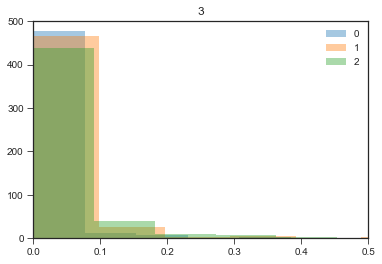

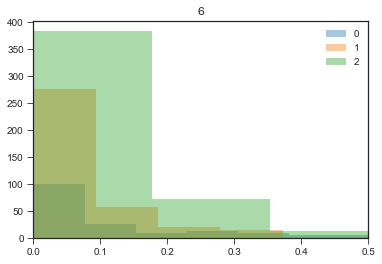

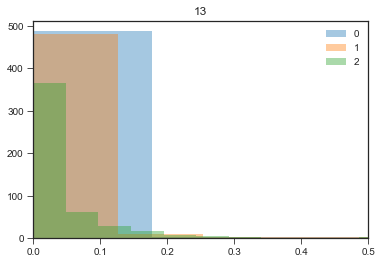

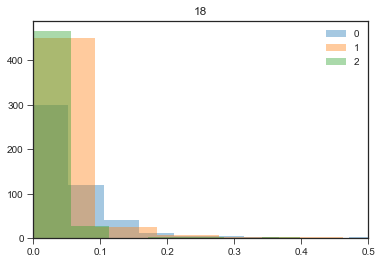

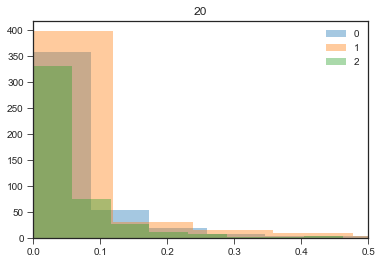

...

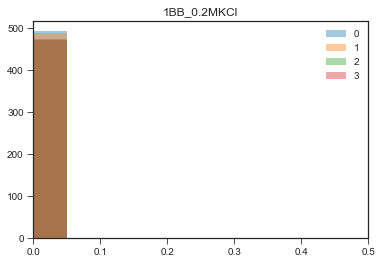

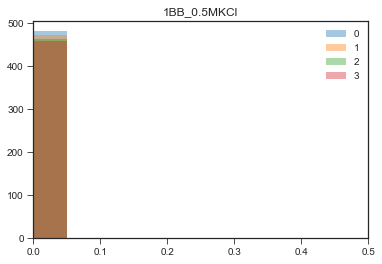

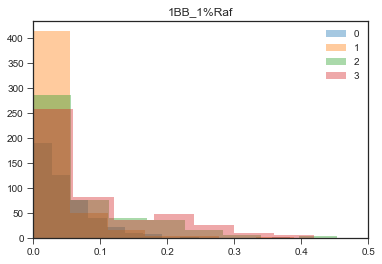

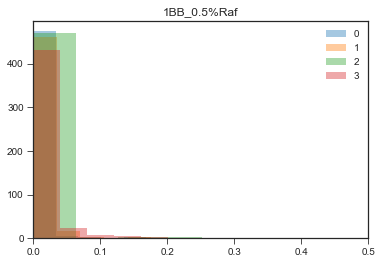

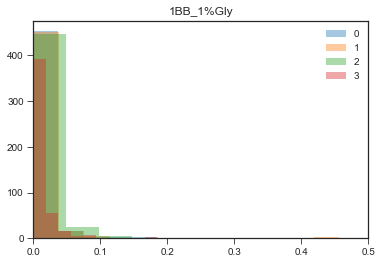

In [10]:
for condition in conditions:
    plt.figure()
    plt.title(condition)
    for t in range(len(rep_variance[condition])):
        sns.distplot([x for x in rep_variance[condition][t] if str(x) != 'nan'],label=str(t),kde=False,bins=20)
        plt.legend()
    plt.xlim(0,0.5)
    

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6448: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


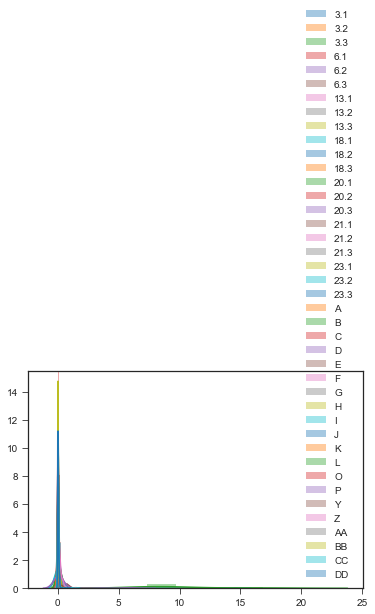

In [11]:
for rep in just_reps:
    
    sns.distplot([x for x in time_variance[rep] if str(x) != 'nan'],label=rep)
    plt.legend()

In [17]:
[rep for condition in bigbatch_conditions for rep in bigbatch_conditions[condition]]

['A',
 'B',
 'C',
 'D',
 'E',
 'F',
 'G',
 'H',
 'I',
 'J',
 'K',
 'L',
 'O',
 'P',
 'Y',
 'Z',
 'AA',
 'BB',
 'CC',
 'DD']

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


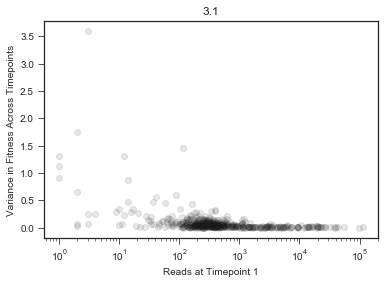

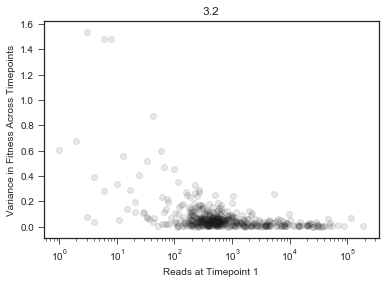

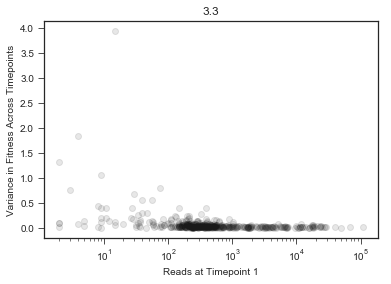

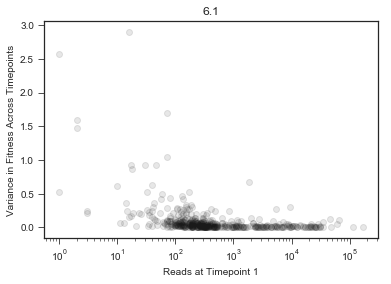

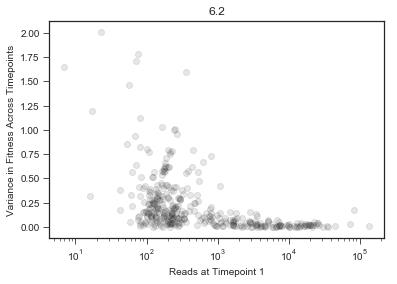

...

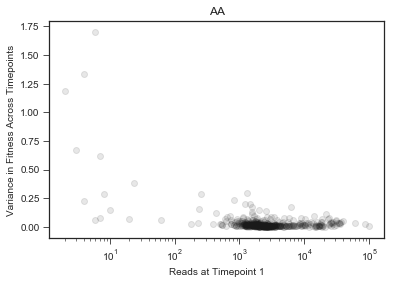

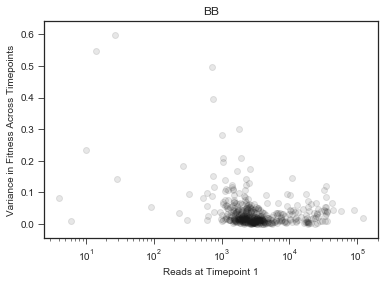

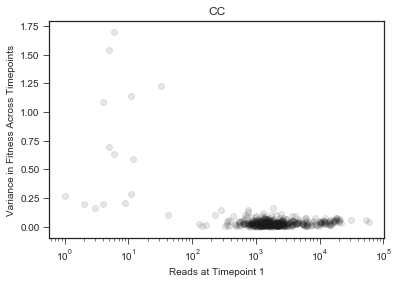

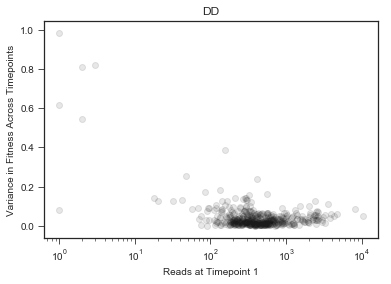

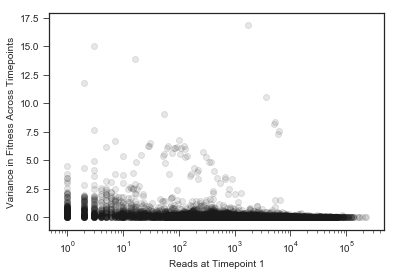

In [70]:
for rep in just_reps:
    plt.figure()
    plt.title(rep)
    if rep in [rep for condition in  bigbatch_conditions for rep in bigbatch_conditions[condition]]:
        t1 = rep + '1'
    else:
        e,r = rep.split('.')
        t1 = e+'-1-'+r
    plt.scatter(data[t1].values,time_variance[rep],color='k',alpha=0.1)
#     len(data[t1].values)
#     plt.yscale('log')
    plt.xscale('log')
#     plt.xlim(100,10**5)
    plt.xlabel('Reads at Timepoint 1')
    plt.ylabel('Variance in Fitness Across Timepoints')
    plt.savefig(f'var_across_time_byreads_{rep}.pdf',bbox_inches='tight')

plt.figure()
for rep in just_reps:
    
#     plt.title(rep)
    if rep in [rep for condition in  bigbatch_conditions for rep in bigbatch_conditions[condition]]:
        t1 = rep + '1'
    else:
        e,r = rep.split('.')
        t1 = e+'-1-'+r
    plt.scatter(data[t1].values,time_variance[rep],color='k',alpha=0.1)
#     len(data[t1].values)
#     plt.yscale('log')
    plt.xscale('log')
#     plt.xlim(100,10**5)
    plt.xlabel('Reads at Timepoint 1')
    plt.ylabel('Variance in Fitness Across Timepoints')
    plt.savefig('var_across_time_byreads_all.pdf',bbox_inches='tight')
#     sns.distplot(,lab
#     sns.distplot(,label=rep)
#     plt.legend()

In [45]:
np.asarray([time_variance[rep] for rep in conditions['1BB_Baffle']]).shape

(2, 548)

In [47]:
np.nanmean(rep_variance['1BB_Baffle'],axis=0)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: Mean of empty slice
  """Entry point for launching an IPython kernel.


array([4.23013643e-04, 1.81916431e-03, 3.71409366e-03, 7.67274963e-04,
       2.94828517e-03, 4.67202655e-03,            nan, 9.13326887e-04,
       6.02209024e-03, 9.32360679e-04,            nan,            nan,
       4.14006657e-03, 5.33716169e-03, 3.20737829e-03, 4.51922964e-03,
       7.47545200e-03, 3.71483180e-03, 5.05848102e-04, 2.47996777e-03,
       1.11550767e-02, 3.41306484e-03, 5.30076370e-03, 4.28624301e-03,
       8.63251147e-04, 2.92572338e-03, 6.26256818e-03, 9.76977147e-02,
       2.84419591e-03,            nan, 1.44957338e-03, 7.33044431e-02,
       1.60873953e-03, 4.47627263e-03, 1.66317964e-03, 8.08990475e-04,
       8.51800907e-03, 5.93940205e-03, 3.20036839e-03, 2.85750254e-03,
       7.96552350e-04, 1.06766006e-02, 2.83374762e-04, 1.07162521e-03,
       1.37127156e-02,            nan, 9.22349553e-03, 1.20170730e-03,
       6.73506585e-03, 4.71079232e-03,            nan, 1.26684992e-03,
       1.90403784e-03, 6.65148616e-03, 7.13508616e-04, 1.04511424e-03,
      

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: Mean of empty slice
  This is separate from the ipykernel package so we can avoid doing imports until
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: Mean of empty slice
  import sys


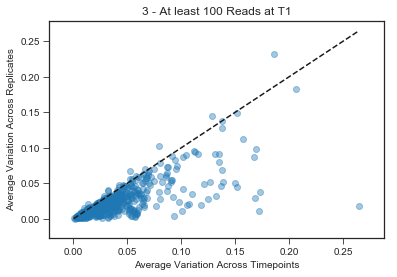

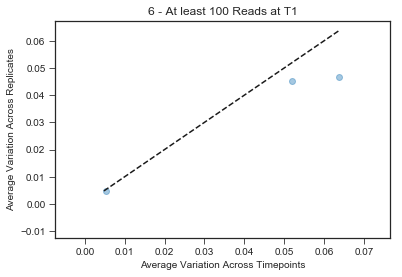

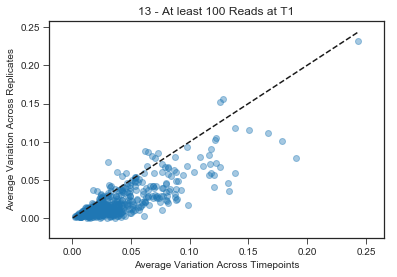

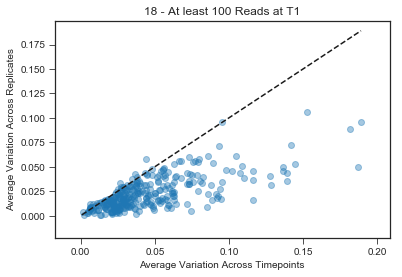

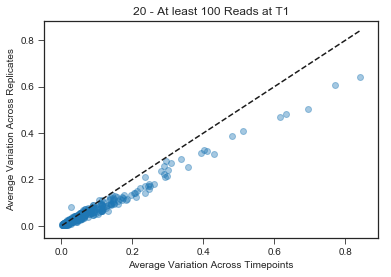

...

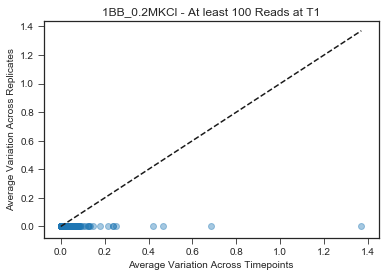

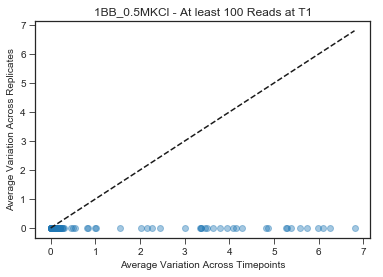

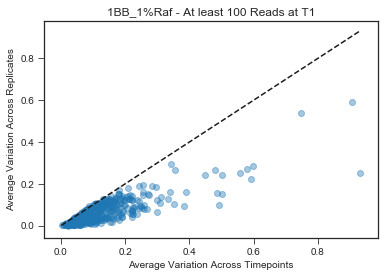

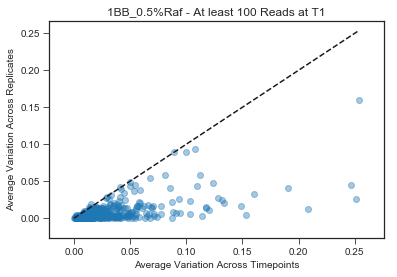

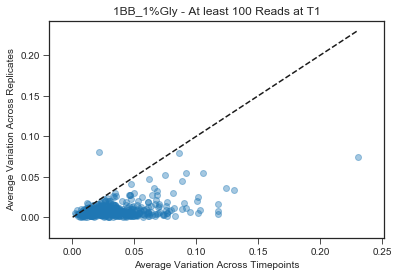

In [72]:
for condition in conditions:
    
    avg_var_across_ts = np.nanmean(np.asarray([time_variance[rep] for rep in conditions[condition]]),axis=0)
        
    this_rep_variance = rep_variance[condition]
        
    avg_var_across_reps = np.nanmean(this_rep_variance,axis=0)
    
    
    
    if condition in bigbatch_conditions:
        reads = data[[rep+'1' for rep in conditions[condition]]].values
    else:
        reads = data[[rep.split('.')[0]+'-1-'+rep.split('.')[1] for rep in conditions[condition]]].values
    
    coverage_cutoff = 100
    cutoff_indices = np.where(np.all(reads>coverage_cutoff,axis=1))[0]
    
    
    plt.figure()
    plt.title(f'{condition} - At least {coverage_cutoff} Reads at T1')
    plt.scatter(avg_var_across_ts[cutoff_indices],avg_var_across_reps[cutoff_indices],alpha=0.4)
    
    bigmin = min([min(avg_var_across_ts[cutoff_indices]),min(avg_var_across_reps[cutoff_indices])])
    bigmax = max([max(avg_var_across_ts[cutoff_indices]),max(avg_var_across_reps[cutoff_indices])])
    plt.plot([bigmin,bigmax],[bigmin,bigmax],'k--')
    plt.xlabel('Average Variation Across Timepoints')
    plt.ylabel('Average Variation Across Replicates')
    
    plt.savefig(f'variation_comparison_across_t_and_rep_{condition}_{coverage_cutoff}.pdf',bbox_inches='tight')
    
#     plt.xscale('log')
#     plt.yscale('log')


    
    
    
    
    
    

In [57]:
reads = data[[rep+'1' for rep in conditions['1BB_M3']]].values

In [73]:
data

,13-0,13-0_pool,13-1-1,13-1-2,13-1-3,13-2-1,13-2-2,13-2-3,13-3-1,13-3-2,...,Z1,Z2,Z3,Z4,additional_muts,barcode,class,gene,ploidy,type
0,2.0,10.0,512.0,700.0,594.0,594.0,403.0,104.0,319.0,299.0,...,1103.0,281.0,15.0,128.0,TIP1-upstream_point_variant; YKR012C-upstream_...,53,Diploid,Diploid,Diploid,Diploid
1,2625.0,3914.0,43106.0,54385.0,42068.0,160273.0,107883.0,20536.0,399304.0,308884.0,...,108918.0,67856.0,3506.0,184186.0,"MIM1,tS-upstream_indel_variant; SEH1-missense_...",151,PKA,IRA1,Haploid,stop_gained
2,15.0,46.0,2909.0,2977.0,2776.0,2582.0,1640.0,442.0,1524.0,1028.0,...,914.0,119.0,6.0,111.0,NotSequenced,262,NotSequenced,NotSequenced,NotSequenced,NotSequenced
3,710.0,1187.0,36510.0,32361.0,30864.0,92924.0,59293.0,14493.0,149876.0,114393.0,...,29997.0,21563.0,935.0,26450.0,None,273,PKA,IRA1,Haploid,frameshift_variant
4,373.0,631.0,21956.0,23483.0,22294.0,46277.0,33707.0,7626.0,79897.0,57846.0,...,10486.0,3452.0,163.0,6759.0,NotSequenced,323,NotSequenced,NotSequenced,NotSequenced,NotSequenced
5,88.0,165.0,2745.0,4386.0,3120.0,7695.0,7096.0,1194.0,17769.0,18873.0,...,32531.0,26118.0,1540.0,36814.0,None,415,PKA,IRA1,Haploid,frameshift_variant
6,48.0,104.0,2335.0,3792.0,3057.0,5985.0,5549.0,1073.0,10823.0,10856.0,...,0.0,0.0,0.0,0.0,NotSequenced,499,NotSequenced,NotSequenced,NotSequenced,NotSequenced
7,0.0,3.0,64.0,57.0,65.0,81.0,27.0,7.0,34.0,23.0,...,464.0,122.0,9.0,81.0,NotSequenced,622,NotSequenced,NotSequenced,NotSequenced,NotSequenced
8,170.0,278.0,5462.0,7846.0,6551.0,15647.0,11789.0,1937.0,28198.0,27943.0,...,8717.0,10034.0,646.0,14755.0,RPL19A-upstream_point_variant,689,PKA,IRA1,Haploid,frameshift_variant
9,6.0,5.0,937.0,1094.0,910.0,936.0,601.0,141.0,581.0,397.0,...,676.0,204.0,5.0,96.0,NotSequenced,697,NotSequenced,NotSequenced,NotSequenced,NotSequenced


In [47]:
these_t_reps = np.asarray([fitnesses[rep][:,t] for rep in ['G','H']])
these_t_reps[these_t_reps == np.inf] = np.nan
these_t_reps = these_t_reps.swapaxes(0,1)
these_t_reps[neutral_locs]
np.nanmean(these_t_reps[neutral_locs],axis=0)

array([-0.83006465, -0.91720585])

In [48]:
 these_t_reps

array([[-0.54928329, -0.56271904],
       [ 0.19723981,  0.24927899],
       [-0.63726993, -0.4869866 ],
       ...,
       [        nan,         nan],
       [ 0.32920387,  0.14136342],
       [ 0.1480285 , -0.01567178]])

In [49]:
np.nanmean(these_t_reps[neutral_locs],axis=0)

array([-0.83006465, -0.91720585])

In [50]:
 these_t_reps - np.nanmean(these_t_reps[neutral_locs],axis=0)

array([[0.28078135, 0.35448681],
       [1.02730446, 1.16648484],
       [0.19279472, 0.43021925],
       ...,
       [       nan,        nan],
       [1.15926852, 1.05856927],
       [0.97809315, 0.90153407]])

In [ ]:
genes = data['gene'].values
plt.figure()
time_names = []
time_places = []

rep_counter = 0
for c,condition in enumerate(conditions):
# for c,condition in enumerate(['1BB_M3','1BB_Baffle']):
# for condition in ['1BB_M3']:
    
    if condition in bigbatch_conditions:
        reps = bigbatch_conditions[condition]
    else:
        reps = old_conditions[condition]
    
    for t in range(fitnesses[reps[0]].shape[1]):
        these_t_reps = np.asarray([fitnesses[rep][:,t] for rep in reps])
        these_t_reps = these_t_reps.swapaxes(0,1)

        these_times = [rep_counter + len(reps)*t + r for r in range(len(reps))] 
        time_places = time_places + these_times
        time_names = time_names + [f'{rep}\n{t}' for rep in reps] 
        for bc in range(these_t_reps.shape[0]):
            if data['barcode'].values[bc] > 9000100:
                plt.plot(these_times,these_t_reps[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
            elif data['barcode'].values[bc] > 9000000:
                plt.plot(these_times,these_t_reps[bc],'o-',color='r',alpha=0.5)
            else:
                plt.plot(these_times,these_t_reps[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
        if t != fitnesses[reps[0]].shape[1]-1:
            plt.axvline(x=rep_counter+len(reps)*(t+1)-0.5,color='gray',linewidth=1)
        else:
            plt.axvline(x=rep_counter+len(reps)*(t+1)-0.5,color='k',linewidth=2)
            
    rep_counter += len(reps)*fitnesses[reps[0]].shape[1]
#     plt.title(f'{condition} Log Frequency Change By Timepoint')
#     plt.ylabel('Log Frequency Change')
plt.xticks(time_places,time_names)
plt.savefig(f'log-frequency_fitness_plots_ALLCONDITONS_bytime.pdf',bbox_inches='tight')
    
        

KeyboardInterrupt: 

([<matplotlib.axis.XTick at 0x13d8a5710>,
 <a list of 16 Text xticklabel objects>)

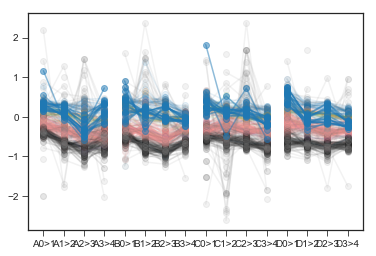

In [81]:
time_names = []
time_places = []
for i,rep in enumerate(['A','B','C','D']):
    these_fitnesses = fitnesses[rep]
#         for t in range(these_fitnesses.shape[1]):

#             x_val = len(reps)*i+t
    these_times = [(these_fitnesses.shape[1])*i + t for t in range(these_fitnesses.shape[1])] 
    time_places = time_places + these_times
    time_names = time_names + [rep + str(t) +'>'+str(t+1) for t in range(these_fitnesses.shape[1])] 
    for bc in range(these_fitnesses.shape[0]):
        if data['barcode'].values[bc] > 9000000:
            plt.plot(these_times,these_fitnesses[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
        else:
            plt.plot(these_times,these_fitnesses[bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.1)
# plt.ylim(-.002,0.01)   
plt.xticks(time_places,time_names)

['3-1-1', '3-2-1', '3-3-1', '3-4-1']
['3-1-2', '3-2-2', '3-3-2', '3-4-2']
['3-1-3', '3-2-3', '3-3-3', '3-4-3']
['6-1-1', '6-2-1', '6-3-1', '6-4-1']
['6-1-2', '6-2-2', '6-3-2', '6-4-2']
['6-1-3', '6-2-3', '6-3-3', '6-4-3']
['13-1-1', '13-2-1', '13-3-1', '13-4-1']
['13-1-2', '13-2-2', '13-3-2', '13-4-2']
['13-1-3', '13-2-3', '13-3-3', '13-4-3']
['18-1-1', '18-2-1', '18-3-1', '18-4-1']
['18-1-2', '18-2-2', '18-3-2', '18-4-2']
['18-1-3', '18-2-3', '18-3-3', '18-4-3']
['20-1-1', '20-2-1', '20-3-1', '20-4-1']
['20-1-2', '20-2-2', '20-3-2', '20-4-2']
['20-1-3', '20-2-3', '20-3-3', '20-4-3']
['21-1-1', '21-2-1', '21-3-1', '21-4-1']
['21-1-2', '21-2-2', '21-3-2', '21-4-2']
['21-1-3', '21-2-3', '21-3-3', '21-4-3']
['23-1-1', '23-2-1', '23-3-1', '23-4-1']
['23-1-2', '23-2-2', '23-3-2', '23-4-2']
['23-1-3', '23-2-3', '23-3-3', '23-4-3']
['A0', 'A1', 'A2', 'A3', 'A4']
['B0', 'B1', 'B2', 'B3', 'B4']
['C0', 'C1', 'C2', 'C3', 'C4']
['D0', 'D1', 'D2', 'D3', 'D4']
['E0', 'E1', 'E2', 'E3', 'E4']
['F0', '

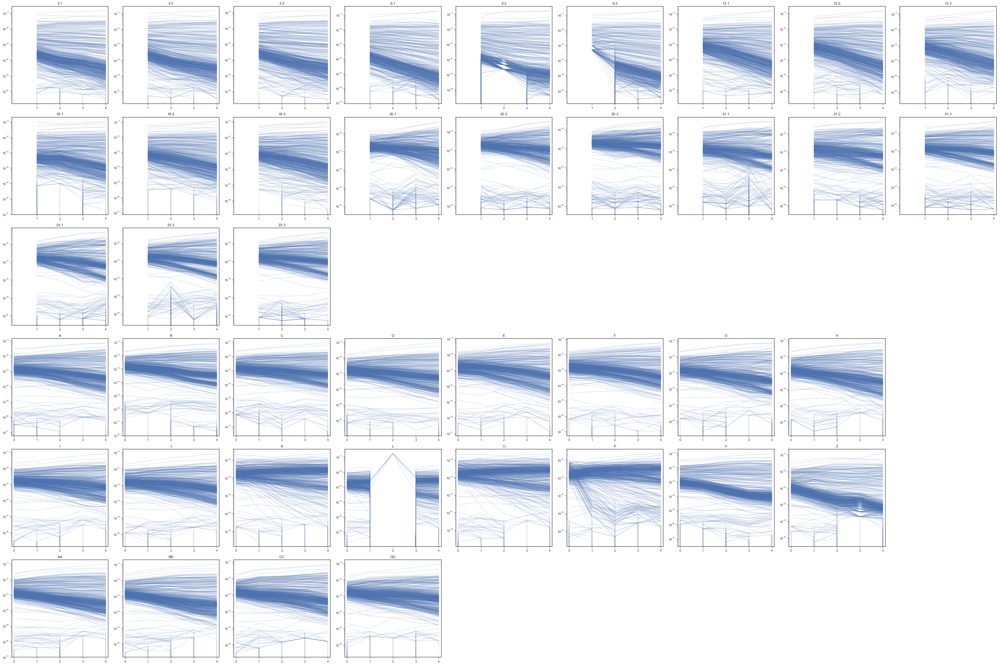

In [35]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]

plt.figure(figsize=(5*9,5*6))
for counter,rep in enumerate(just_reps):
    if rep in  tools.flatten([i for i in bigbatch_conditions.values()]):
        counter = counter + 6
        if counter-26 >= 9:
            counter += 1
        if counter-26 >= 18:
            counter += 1
    ax = plt.subplot(6,9,counter+1)
    timepoints = []
    these_times = []
    if rep in tools.flatten([i for i in old_conditions.values()]):
        e,r = rep.split('.')
#         if e in ['13','15']:
#             timepoints.append(0)
#             these_times.append('13-0_pool')
#         else:
#             if e+'-0' in data.columns:
#                 timepoints.append(0)
#                 these_times.append(e+'-0')

        for t in range(1,5):
            if e+'-'+str(t)+'-'+r in data.columns:
                timepoints.append(t)
                these_times.append(e+'-'+str(t)+'-'+r)

    if rep in tools.flatten([i for i in bigbatch_conditions.values()]):
        for i in range(5):
            if rep+str(i) in data.columns:
                these_times.append(rep+str(i))
                timepoints.append(i)
    print(these_times)
    BC_counts = data[these_times].values
    ax.plot(timepoints,(BC_counts/np.nansum(BC_counts,axis=0)).swapaxes(0,1),alpha=0.2,color='b')
    plt.yscale('log')
#     plt.title(codenames[condition])
    plt.title(rep)
    plt.tight_layout()
    plt.xticks(timepoints,timepoints)
    plt.xlim(-0.1,4.1)
# plt.savefig(f'Alltrajectories_old+1bb_swapscorrected_reshape.pdf',bbox_inches='tight')

In [5]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data = data.sort_values('barcode')
data = data.drop(columns=['L2','6-1-3','6-2-2']) # sparse timepoints resulting a lot of missing data

cov_thresh = 100

### called neutral by atish's method in ALL 5000 bc experiments (I think - need to verify this)
### [could also be below some set threshold across all experiments]
full_neutral_list = [17615,18486,42040,45014,58284,63611,73731,74185,80465,94896
,120600,125697,132511,134852,135750,190551,228237,238783,255561,298344
,308537,316954,317346,335717,411685,454359,469053] 

### from previous list but never has fitness above 3.5% (per gen) in any of 5000bc experiments
supergood_neutral = [17615, 24362, 42040, 71926, 72939, 73802, 80465, 109476, 113483, 
                     134852, 135750, 238783, 263665, 276406, 316954, 335717, 454359] 

### pulled from supergood list and spiked into 1BigBatch experiments
neutral_spikes = [17615,24362,42040,71926,73802,109476,113483,134852,263665,316954]

# neutrals = full_neutral_list
neutrals = list(np.unique(full_neutral_list+supergood_neutral+neutral_spikes))

neutrals = [bc for bc in data['barcode'].values if bc in neutrals]
# neutrals = neutral_spikes
print(neutrals)

fitnesses = {}

other_info = ['barcode','gene','type','ploidy','class','additional_muts']

for condition,replicates in conditions.items():
    print(condition)
    print(replicates)
    rep_times = {}
    for rep in replicates:
        
        these_times = []
        timepoints = []
        if condition in old_conditions.keys():
            
            e,r = rep.split('.')
#             if e in ['13','15']:
#                 timepoints.append(0)
#                 these_times.append('13-0_pool')
#             else:
#                 if e+'-0' in data.columns:
#                     timepoints.append(0)
#                     these_times.append(e+'-0')
            for t in range(1,5):
                if e+'-'+str(t)+'-'+r in data.columns:
                    timepoints.append(t)
                    these_times.append(e+'-'+str(t)+'-'+r)

        if condition in bigbatch_conditions.keys():
            for i in range(5):
                if rep+str(i) in data.columns:
                    these_times.append(rep+str(i))
                    timepoints.append(i)
        rep_times[rep] = data[these_times].values
        print(timepoints)
        print(rep)
    answer = atish.inferFitness(data['barcode'].values,timepoints,rep_times,
                                neutralBarcodes=neutrals,lowCoverageThresh=cov_thresh,use_all_neutral=True,useMultNoise=True,weightedMean=False)


    for rep in replicates:

        fitnesses[rep+'_fitness'] = answer[rep]['aveFitness']
        fitnesses[rep+'_error'] = answer[rep]['aveError']

for other_setting in other_info:
    if other_setting in data.columns:
        fitnesses[other_setting] = data[other_setting].values

fitness_df = p.DataFrame(fitnesses)
fitness_df = fitness_df.replace([np.inf, -np.inf], np.nan)
# fitness_df = fitness_df.replace([float('Inf'),-float('Inf'),np.inf, -np.inf], np.nan)

for condition,replicates in conditions.items():
    
    
    fitness_df[condition+'_fitness'] = np.nansum([fitness_df[rep+'_fitness'].values/fitness_df[rep+'_error'].values for rep in replicates],axis=0) \
    /np.nansum([1.0/fitness_df[rep+'_error'].values for rep in replicates],axis=0)
    
    fitness_df[condition+'_error'] = np.nansum([1.0/fitness_df[rep+'_error'].values for rep in replicates],axis=0)**(-1)


    
fitness_df_unweighted = fitness_df[other_info+[col for col in fitness_df if col not in other_info]]
# fitness_df.to_csv('../data/DoubleBC_Merged_Fitness_Atish_Default_AllConditions.csv',index=False)


[17615, 24362, 42040, 71926, 72939, 73802, 109476, 113483, 120600, 134852, 263665, 298344, 316954]
3
['3.1', '3.2', '3.3']
[1, 2, 3, 4]
3.1
[1, 2, 3, 4]
3.2
[1, 2, 3, 4]
3.3
neutral reads 2880.0 1653.0
neutral reads 1653.0 557.0
neutral reads 557.0 391.0
neutral reads 2880.0 1653.0
neutral reads 1653.0 557.0
neutral reads 557.0 391.0
neutral reads 3939.0 1558.0
neutral reads 1558.0 782.0
neutral reads 782.0 284.0
neutral reads 3939.0 1558.0
neutral reads 1558.0 782.0
neutral reads 782.0 284.0
neutral reads 3368.0 1959.0
neutral reads 1959.0 776.0
neutral reads 776.0 430.0
neutral reads 3368.0 1959.0
neutral reads 1959.0 776.0
neutral reads 776.0 430.0
Multiplicative noise consistency checks

3.1  inconsistent times:

kappas [1.7437897  2.31538368 1.81788505]
multNoise [0.11285201 0.11902568 0.10235688]
No clear inconsistencies


3.2  inconsistent times:

kappas [4.73791928 5.1001428  1.46530054]
multNoise [0.11285201 0.11902568 0.10235688]
No clear inconsistencies


3.3  inconsistent t

/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:219: RuntimeWarning: divide by zero encountered in power
  zScores = zScores*np.power(expectedReads,-0.5)
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:219: RuntimeWarning: invalid value encountered in multiply
  zScores = zScores*np.power(expectedReads,-0.5)
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:386: RuntimeWarning: divide by zero encountered in log
  allTimeFitness = np.log(allReads[repName][:,1:]/totReads[1:])-np.log(allReads[repName][:,0:-1]/totReads[0:-1])
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:386: RuntimeWarning: invalid value encountered in subtract
  allTimeFitness = np.log(allReads[repName][:,1:]/totReads[1:])-np.log(allReads[repName][:,0:-1]/totReads[0:-1])
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_a

neutral reads 41341.0 50223.0
neutral reads 22513.0 60230.0
neutral reads 60230.0 78877.0
neutral reads 78877.0 7367.0
neutral reads 7367.0 26379.0
neutral reads 22513.0 60230.0
neutral reads 60230.0 78877.0
neutral reads 78877.0 7367.0
neutral reads 7367.0 26379.0
neutral reads 30234.0 41324.0
neutral reads 41324.0 15145.0
neutral reads 15145.0 10807.0
neutral reads 10807.0 5803.0
neutral reads 30234.0 41324.0
neutral reads 41324.0 15145.0
neutral reads 15145.0 10807.0
neutral reads 10807.0 5803.0
Multiplicative noise consistency checks

A  inconsistent times:

kappas [22.50760306 10.39824995  2.77877172  4.6789351 ]
multNoise [0.1522296  0.13235833 0.14592807 0.11573647]
No clear inconsistencies


B  inconsistent times:

kappas [15.32883373 33.35153686  9.42941125 11.68090649]
multNoise [0.1522296  0.13235833 0.14592807 0.11573647]
No clear inconsistencies


C  inconsistent times:

kappas [19.03764723 36.78004103  3.35980647  9.39322037]
multNoise [0.1522296  0.13235833 0.14592807 0.

In [6]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data = data.sort_values('barcode')
data = data.drop(columns=['L2','6-1-3','6-2-2']) # sparse timepoints resulting a lot of missing data

cov_thresh = 100

### called neutral by atish's method in ALL 5000 bc experiments (I think - need to verify this)
### [could also be below some set threshold across all experiments]
full_neutral_list = [17615,18486,42040,45014,58284,63611,73731,74185,80465,94896
,120600,125697,132511,134852,135750,190551,228237,238783,255561,298344
,308537,316954,317346,335717,411685,454359,469053] 

### from previous list but never has fitness above 3.5% (per gen) in any of 5000bc experiments
supergood_neutral = [17615, 24362, 42040, 71926, 72939, 73802, 80465, 109476, 113483, 
                     134852, 135750, 238783, 263665, 276406, 316954, 335717, 454359] 

### pulled from supergood list and spiked into 1BigBatch experiments
neutral_spikes = [17615,24362,42040,71926,73802,109476,113483,134852,263665,316954]

# neutrals = full_neutral_list
neutrals = list(np.unique(full_neutral_list+supergood_neutral+neutral_spikes))

neutrals = [bc for bc in data['barcode'].values if bc in neutrals]
# neutrals = neutral_spikes
print(neutrals)

fitnesses = {}

other_info = ['barcode','gene','type','ploidy','class','additional_muts']

for condition,replicates in conditions.items():
    print(condition)
    print(replicates)
    rep_times = {}
    for rep in replicates:
        
        these_times = []
        timepoints = []
        if condition in old_conditions.keys():
            
            e,r = rep.split('.')
#             if e in ['13','15']:
#                 timepoints.append(0)
#                 these_times.append('13-0_pool')
#             else:
#                 if e+'-0' in data.columns:
#                     timepoints.append(0)
#                     these_times.append(e+'-0')
            for t in range(1,5):
                if e+'-'+str(t)+'-'+r in data.columns:
                    timepoints.append(t)
                    these_times.append(e+'-'+str(t)+'-'+r)

        if condition in bigbatch_conditions.keys():
            for i in range(5):
                if rep+str(i) in data.columns:
                    these_times.append(rep+str(i))
                    timepoints.append(i)
        rep_times[rep] = data[these_times].values
        print(timepoints)
        print(rep)
    answer = atish.inferFitness(data['barcode'].values,timepoints,rep_times,
                                neutralBarcodes=neutrals,lowCoverageThresh=cov_thresh,use_all_neutral=True,useMultNoise=True,weightedMean=True)


    for rep in replicates:

        fitnesses[rep+'_fitness'] = answer[rep]['aveFitness']
        fitnesses[rep+'_error'] = answer[rep]['aveError']

for other_setting in other_info:
    if other_setting in data.columns:
        fitnesses[other_setting] = data[other_setting].values

fitness_df = p.DataFrame(fitnesses)
fitness_df = fitness_df.replace([np.inf, -np.inf], np.nan)
# fitness_df = fitness_df.replace([float('Inf'),-float('Inf'),np.inf, -np.inf], np.nan)

for condition,replicates in conditions.items():
    
    
    fitness_df[condition+'_fitness'] = np.nansum([fitness_df[rep+'_fitness'].values/fitness_df[rep+'_error'].values for rep in replicates],axis=0) \
    /np.nansum([1.0/fitness_df[rep+'_error'].values for rep in replicates],axis=0)
    
    fitness_df[condition+'_error'] = np.nansum([1.0/fitness_df[rep+'_error'].values for rep in replicates],axis=0)**(-1)


    
fitness_df_weighted = fitness_df[other_info+[col for col in fitness_df if col not in other_info]]
# fitness_df.to_csv('../data/DoubleBC_Merged_Fitness_Atish_Default_AllConditions.csv',index=False)



[17615, 24362, 42040, 71926, 72939, 73802, 109476, 113483, 120600, 134852, 263665, 298344, 316954]
3
['3.1', '3.2', '3.3']
[1, 2, 3, 4]
3.1
[1, 2, 3, 4]
3.2
[1, 2, 3, 4]
3.3
neutral reads 2880.0 1653.0
neutral reads 1653.0 557.0
neutral reads 557.0 391.0
neutral reads 2880.0 1653.0
neutral reads 1653.0 557.0
neutral reads 557.0 391.0
neutral reads 3939.0 1558.0
neutral reads 1558.0 782.0
neutral reads 782.0 284.0
neutral reads 3939.0 1558.0
neutral reads 1558.0 782.0
neutral reads 782.0 284.0
neutral reads 3368.0 1959.0
neutral reads 1959.0 776.0
neutral reads 776.0 430.0
neutral reads 3368.0 1959.0
neutral reads 1959.0 776.0
neutral reads 776.0 430.0
Multiplicative noise consistency checks

3.1  inconsistent times:

kappas [1.7437897  2.31538368 1.81788505]
multNoise [0.11285201 0.11902568 0.10235688]
No clear inconsistencies


3.2  inconsistent times:

kappas [4.73791928 5.1001428  1.46530054]
multNoise [0.11285201 0.11902568 0.10235688]
No clear inconsistencies


3.3  inconsistent t

/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:219: RuntimeWarning: divide by zero encountered in power
  zScores = zScores*np.power(expectedReads,-0.5)
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:219: RuntimeWarning: invalid value encountered in multiply
  zScores = zScores*np.power(expectedReads,-0.5)
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:386: RuntimeWarning: divide by zero encountered in log
  allTimeFitness = np.log(allReads[repName][:,1:]/totReads[1:])-np.log(allReads[repName][:,0:-1]/totReads[0:-1])
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:386: RuntimeWarning: invalid value encountered in subtract
  allTimeFitness = np.log(allReads[repName][:,1:]/totReads[1:])-np.log(allReads[repName][:,0:-1]/totReads[0:-1])
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_a

neutral reads 4090.0 2849.0
neutral reads 2849.0 1054.0
neutral reads 1054.0 681.0
neutral reads 4090.0 2849.0
neutral reads 2849.0 1054.0
neutral reads 1054.0 681.0
neutral reads 5114.0 3611.0
neutral reads 3611.0 1950.0
neutral reads 1950.0 977.0
neutral reads 5114.0 3609.0
neutral reads 3609.0 1950.0
neutral reads 1950.0 977.0
neutral reads 4793.0 3764.0
neutral reads 3764.0 1716.0
neutral reads 1716.0 891.0
neutral reads 4793.0 3763.0
neutral reads 3763.0 1716.0
neutral reads 1716.0 891.0
Multiplicative noise consistency checks

23.1  inconsistent times:

kappas [ 5.23085535  5.02580632 14.24103309]
multNoise [0.1111914  0.22360996 0.19588799]
No clear inconsistencies


23.2  inconsistent times:

kappas [12.92087     2.68153465  0.42254651]
multNoise [0.1111914  0.22360996 0.19588799]
No clear inconsistencies


23.3  inconsistent times:

kappas [3.21657572 2.28271529 0.75594518]
multNoise [0.1111914  0.22360996 0.19588799]
No clear inconsistencies

1BB_M3
['A', 'B', 'C', 'D']
[0, 1

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:83: RuntimeWarning: invalid value encountered in true_divide
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:85: RuntimeWarning: divide by zero encountered in reciprocal


In [13]:
[i for i in range(1,3)]

[1, 2]

In [124]:
fitness_df.replace([np.inf, -np.inf], np.nan)

,barcode,gene,type,ploidy,class,additional_muts,13.1_error,13.1_fitness,13.2_error,13.2_fitness,...,1BB_0.2MNaCl_fitness,1BB_0.2MNaCl_error,1BB_0.2MKCl_fitness,1BB_0.2MKCl_error,1BB_0.5MKCl_fitness,1BB_0.5MKCl_error,1BB_0.5%Raf_fitness,1BB_0.5%Raf_error,1BB_1%Gly_fitness,1BB_1%Gly_error
0,53,Diploid,Diploid,Diploid,Diploid,TIP1-upstream_point_variant; YKR012C-upstream_...,0.084158,0.319887,0.080264,0.284783,...,0.082724,0.060322,0.517133,0.054619,0.281774,0.059401,0.267503,0.024743,0.351641,0.031392
1,151,IRA1,stop_gained,Haploid,PKA,"MIM1,tS-upstream_indel_variant; YFL019C,SUF9-u...",0.045954,0.215119,0.045518,0.224971,...,0.990029,0.050504,0.252553,0.050905,-2.547008,0.103433,1.004842,0.017600,1.018480,0.024649
2,262,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.063284,0.133557,0.062654,0.058471,...,0.138540,0.063584,0.562643,0.055950,0.301131,0.061419,0.288765,0.025901,0.358404,0.032418
3,273,IRA1,frameshift_variant,Haploid,PKA,NaN,0.046382,0.346726,0.046767,0.357501,...,0.733651,0.050832,0.425995,0.051479,-1.036554,0.081520,0.778585,0.017914,0.787411,0.025075
4,323,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.047905,0.456146,0.047768,0.455681,...,0.701008,0.051590,0.421169,0.052638,-0.430072,0.070879,0.647284,0.018741,0.664027,0.025911
5,415,IRA1,frameshift_variant,Haploid,PKA,NaN,0.056073,0.967334,0.054489,0.918439,...,0.969724,0.050702,-0.290556,0.062332,-3.652083,0.218403,0.889023,0.017789,0.967308,0.025020
6,499,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.056917,0.923488,0.055227,0.874089,...,0.000000,4.176465,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,622,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.165185,0.352706,0.232483,0.065942,...,-0.028748,0.066156,0.507302,0.056559,0.260380,0.062638,0.188938,0.027013,0.310583,0.034162
8,689,IRA1,frameshift_variant,Haploid,PKA,RPL19A-upstream_point_variant,0.053402,0.817965,0.052065,0.743315,...,0.987435,0.051392,-0.616392,0.096871,-3.315940,0.496535,0.994024,0.018229,1.068526,0.025928
9,697,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.075625,0.347717,0.075000,0.278913,...,0.091431,0.063976,0.468017,0.056099,0.301192,0.061008,0.216814,0.026500,0.306125,0.033305


In [113]:
data

,13-0,13-0_pool,13-1-1,13-1-2,13-1-3,13-2-1,13-2-2,13-2-3,13-3-1,13-3-2,...,Z1,Z2,Z3,Z4,additional_muts,barcode,class,gene,ploidy,type
0,2.0,10.0,512.0,700.0,594.0,594.0,403.0,104.0,319.0,299.0,...,1103.0,281.0,15.0,128.0,TIP1-upstream_point_variant; YKR012C-upstream_...,53,Diploid,Diploid,Diploid,Diploid
1,2625.0,3914.0,43106.0,54385.0,42068.0,160273.0,107883.0,20536.0,399304.0,308884.0,...,108918.0,67856.0,3506.0,184186.0,"MIM1,tS-upstream_indel_variant; YFL019C,SUF9-u...",151,RAS,IRA1,Haploid,stop_gained
2,15.0,46.0,2909.0,2977.0,2776.0,2582.0,1640.0,442.0,1524.0,1028.0,...,914.0,119.0,6.0,111.0,NotSequenced,262,NotSequenced,NotSequenced,NotSequenced,NotSequenced
3,710.0,1187.0,36510.0,32361.0,30864.0,92924.0,59293.0,14493.0,149876.0,114393.0,...,29997.0,21563.0,935.0,26450.0,NaN,273,RAS,IRA1,Haploid,frameshift_variant
4,373.0,631.0,21956.0,23483.0,22294.0,46277.0,33707.0,7626.0,79897.0,57846.0,...,10486.0,3452.0,163.0,6759.0,NotSequenced,323,NotSequenced,NotSequenced,NotSequenced,NotSequenced
5,88.0,165.0,2745.0,4386.0,3120.0,7695.0,7096.0,1194.0,17769.0,18873.0,...,32531.0,26118.0,1540.0,36814.0,NaN,415,RAS,IRA1,Haploid,frameshift_variant
6,48.0,104.0,2335.0,3792.0,3057.0,5985.0,5549.0,1073.0,10823.0,10856.0,...,0.0,0.0,0.0,0.0,NotSequenced,499,NotSequenced,NotSequenced,NotSequenced,NotSequenced
7,0.0,3.0,64.0,57.0,65.0,81.0,27.0,7.0,34.0,23.0,...,464.0,122.0,9.0,81.0,NotSequenced,622,NotSequenced,NotSequenced,NotSequenced,NotSequenced
8,170.0,278.0,5462.0,7846.0,6551.0,15647.0,11789.0,1937.0,28198.0,27943.0,...,8717.0,10034.0,646.0,14755.0,RPL19A-upstream_point_variant,689,RAS,IRA1,Haploid,frameshift_variant
9,6.0,5.0,937.0,1094.0,910.0,936.0,601.0,141.0,581.0,397.0,...,676.0,204.0,5.0,96.0,NotSequenced,697,NotSequenced,NotSequenced,NotSequenced,NotSequenced


In [21]:
fitness_df_unweighted

,barcode,gene,type,ploidy,class,additional_muts,13.1_error,13.1_fitness,13.2_error,13.2_fitness,...,1BB_0.2MKCl_fitness,1BB_0.2MKCl_error,1BB_0.5MKCl_fitness,1BB_0.5MKCl_error,1BB_1%Raf_fitness,1BB_1%Raf_error,1BB_0.5%Raf_fitness,1BB_0.5%Raf_error,1BB_1%Gly_fitness,1BB_1%Gly_error
0,53,Diploid,Diploid,Diploid,Diploid,TIP1-upstream_point_variant; YKR012C-upstream_...,0.57735,0.308703,0.57735,0.325434,...,0.515387,0.5,0.272456,0.5,0.080175,0.25,0.291578,0.25,0.345798,0.25
1,151,IRA1,stop_gained,Haploid,PKA,"MIM1,tS-upstream_indel_variant; SEH1-missense_...",0.57735,1.625437,0.57735,1.590296,...,0.250768,0.5,-1.246808,0.5,0.961259,0.25,1.016836,0.25,1.037794,0.25
2,262,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.57735,0.176681,0.57735,0.120540,...,0.562300,0.5,0.302375,0.5,0.086465,0.25,0.318271,0.25,0.331125,0.25
3,273,IRA1,frameshift_variant,Haploid,PKA,None,0.57735,1.148256,0.57735,1.240145,...,0.423458,0.5,-0.931973,0.5,0.730745,0.25,0.798139,0.25,0.821151,0.25
4,323,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.57735,1.131856,0.57735,1.123449,...,0.417285,0.5,-0.412933,0.5,0.629773,0.25,0.621260,0.25,0.661706,0.25
5,415,IRA1,frameshift_variant,Haploid,PKA,None,0.57735,1.363798,0.57735,1.378604,...,-0.335889,0.5,-1.311559,0.5,0.899605,0.25,0.909438,0.25,0.973771,0.25
6,499,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.57735,1.217275,0.57735,1.204252,...,0.000000,0.5,0.000000,0.5,0.000000,0.25,0.000000,0.25,0.000000,0.25
7,622,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.57735,0.288495,0.57735,0.111483,...,0.503421,0.5,0.246780,0.5,0.046780,0.25,0.216733,0.25,0.305084,0.25
8,689,IRA1,frameshift_variant,Haploid,PKA,RPL19A-upstream_point_variant,0.57735,1.342308,0.57735,1.322521,...,-0.734513,0.5,-1.169519,0.5,0.965521,0.25,1.022488,0.25,1.075987,0.25
9,697,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.57735,0.253124,0.57735,0.208366,...,0.462017,0.5,0.273833,0.5,0.087530,0.25,0.230261,0.25,0.287356,0.25


In [22]:
fitness_df_weighted

,barcode,gene,type,ploidy,class,additional_muts,13.1_error,13.1_fitness,13.2_error,13.2_fitness,...,1BB_0.2MKCl_fitness,1BB_0.2MKCl_error,1BB_0.5MKCl_fitness,1BB_0.5MKCl_error,1BB_1%Raf_fitness,1BB_1%Raf_error,1BB_0.5%Raf_fitness,1BB_0.5%Raf_error,1BB_1%Gly_fitness,1BB_1%Gly_error
0,53,Diploid,Diploid,Diploid,Diploid,TIP1-upstream_point_variant; YKR012C-upstream_...,0.086877,0.366047,0.083404,0.315150,...,0.517133,0.054619,0.281774,0.059401,0.082724,0.060322,0.267503,0.024743,0.351641,0.031392
1,151,IRA1,stop_gained,Haploid,PKA,"MIM1,tS-upstream_indel_variant; SEH1-missense_...",0.059241,1.628226,0.059251,1.570717,...,0.252553,0.050905,-2.547008,0.103433,0.990029,0.050504,1.004842,0.017600,1.018480,0.024649
2,262,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.069475,0.196277,0.068634,0.105044,...,0.562643,0.055950,0.301131,0.061419,0.138540,0.063584,0.288765,0.025901,0.358404,0.032418
3,273,IRA1,frameshift_variant,Haploid,PKA,None,0.059303,1.133521,0.059304,1.206520,...,0.425995,0.051479,-1.036554,0.081520,0.733651,0.050832,0.778585,0.017914,0.787411,0.025075
4,323,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.059382,1.113742,0.059383,1.101149,...,0.421169,0.052638,-0.430072,0.070879,0.701008,0.051590,0.647284,0.018741,0.664027,0.025911
5,415,IRA1,frameshift_variant,Haploid,PKA,None,0.060026,1.328568,0.059880,1.330132,...,-0.290556,0.062332,-3.652083,0.218403,0.969724,0.050702,0.889023,0.017789,0.967308,0.025020
6,499,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.060481,1.198759,0.060173,1.177681,...,NaN,inf,NaN,inf,0.000000,4.176465,NaN,inf,NaN,inf
7,622,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.167772,0.403564,0.238859,0.147452,...,0.507302,0.056559,0.260380,0.062638,-0.028748,0.066156,0.188938,0.027013,0.310583,0.034162
8,689,IRA1,frameshift_variant,Haploid,PKA,RPL19A-upstream_point_variant,0.059639,1.351715,0.059628,1.287908,...,-0.616392,0.096871,-3.315940,0.496535,0.987435,0.051392,0.994024,0.018229,1.068526,0.025928
9,697,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.079211,0.292709,0.078981,0.195564,...,0.468017,0.056099,0.301192,0.061008,0.091431,0.063976,0.216814,0.026500,0.306125,0.033305


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:32: RuntimeWarning: Degrees of freedom <= 0 for slice.


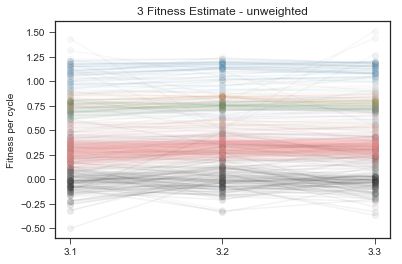

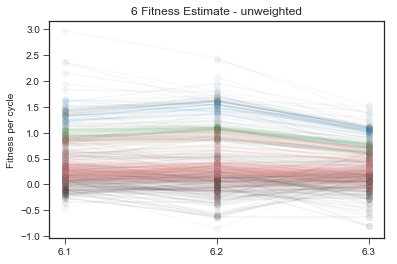

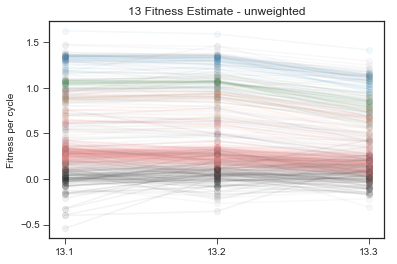

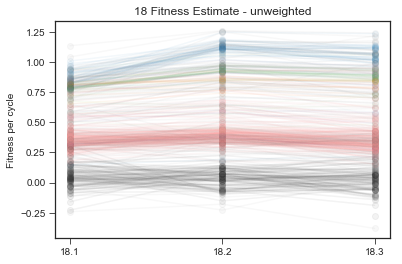

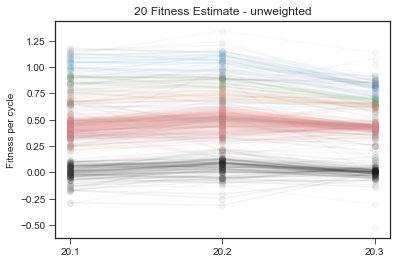

...

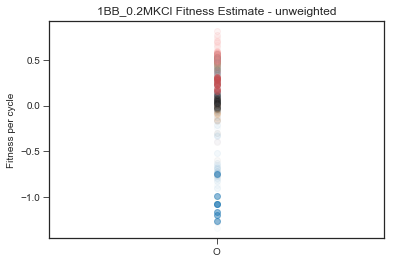

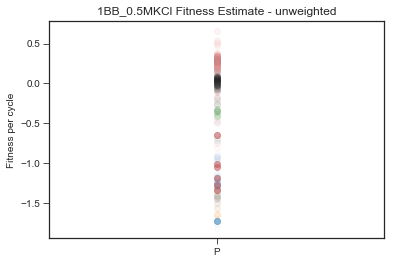

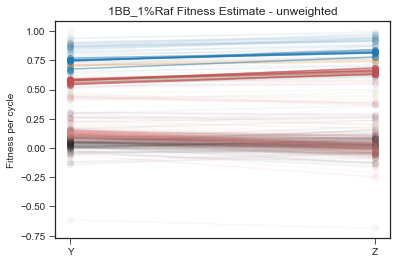

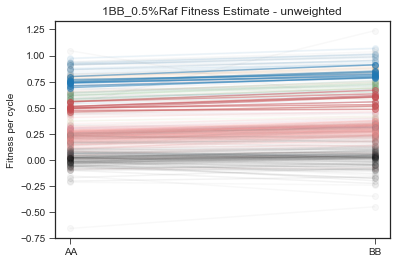

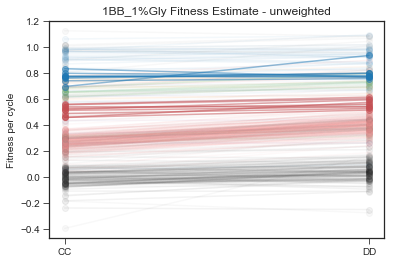

In [16]:
this_fitness = fitness_df_unweighted

genes = this_fitness['gene'].values
bc_variances = []
for c,condition in enumerate(conditions):
# for condition in ['1BB_M3']:
    bc_variances.append([])
    plt.figure()
    if condition in bigbatch_conditions:
        reps = bigbatch_conditions[condition]
    else:
        reps = old_conditions[condition]
    
    
    these_rep_fitness = this_fitness[[rep+'_fitness' for rep in reps]].values
    
#     for t in range(fitnesses[reps[0]].shape[1]):
#         these_t_reps = np.asarray([fitnesses[rep][:,t] for rep in reps])
#         these_t_reps = these_t_reps.swapaxes(0,1)

#         these_times = [len(reps)*t + r for r in range(len(reps))] 
#         time_places = time_places + these_times
#         time_names = time_names + [f'{rep}\n{t}' for rep in reps] 
    for bc in range(these_rep_fitness.shape[0]):
        if data['barcode'].values[bc] > 9000100:
            plt.plot(range(len(reps)),these_rep_fitness[bc,:],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
        elif data['barcode'].values[bc] > 9000000:
            plt.plot(range(len(reps)),these_rep_fitness[bc,:],'o-',color='r',alpha=0.5)
        else:
            plt.plot(range(len(reps)),these_rep_fitness[bc,:],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
            
        bc_variances[c].append(np.nanvar(these_rep_fitness[bc,:]))
#         if t != fitnesses[reps[0]].shape[1]-1:
#             plt.axvline(x=len(reps)*(t+1)-0.5,color='k') 
    plt.title(f'{condition} Fitness Estimate - unweighted')
    plt.ylabel('Fitness per cycle')
    plt.xticks(range(len(reps)),reps)
    plt.savefig(f'fitness_plots_{condition}_unweighted.pdf',bbox_inches='tight')
    
unweighted_variance = np.asarray(bc_variances)

In [25]:
unweighted_variance.shape

(17, 548)

(1e-09, 0.5)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/scale.py:114: RuntimeWarning: invalid value encountered in less_equal
  out[a <= 0] = -1000


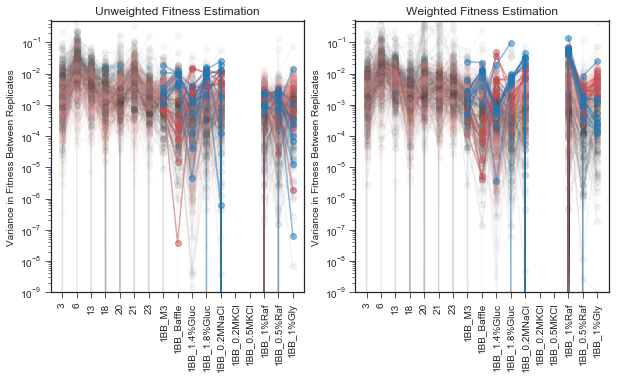

In [40]:
# unweighted_variance = np.asarray(bc_variances)
f, (ax1, ax2) = plt.subplots(1,2,sharey=True,figsize=(10,5))
ax1 = plt.subplot(121)
for bc in range(unweighted_variance.shape[1]):
    if data['barcode'].values[bc] > 9000100:
        ax1.plot(unweighted_variance[:,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
    elif data['barcode'].values[bc] > 9000000:
        ax1.plot(unweighted_variance[:,bc],'o-',color='r',alpha=0.5)
    else:
        ax1.plot(unweighted_variance[:,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
plt.xticks(range(len(conditions)),conditions,rotation=90)
plt.title('Unweighted Fitness Estimation')
plt.ylabel('Variance in Fitness Between Replicates')
plt.yscale('log')
plt.ylim(10**-9,0.5)
# plt.yscale('log')

ax2 = plt.subplot(122)
for bc in range(weighted_variance.shape[1]):
    if data['barcode'].values[bc] > 9000100:
        ax2.plot(weighted_variance[:,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
    elif data['barcode'].values[bc] > 9000000:
        ax2.plot(weighted_variance[:,bc],'o-',color='r',alpha=0.5)
    else:
        ax2.plot(weighted_variance[:,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
plt.xticks(range(len(conditions)),conditions,rotation=90)
plt.title('Weighted Fitness Estimation')
plt.ylabel('Variance in Fitness Between Replicates')
plt.yscale('log')
plt.ylim(10**-9,0.5)



/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/ma/core.py:2144: RuntimeWarning: invalid value encountered in greater_equal
  condition = (xf >= v1) & (xf <= v2)
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/numpy/ma/core.py:2144: RuntimeWarning: invalid value encountered in less_equal
  condition = (xf >= v1) & (xf <= v2)


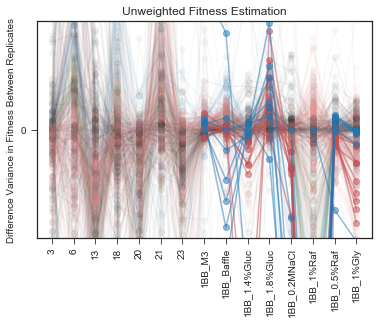

In [81]:
variance_difference = unweighted_variance-weighted_variance

condition_indices = list(range(12))+list(range(14,17))

for bc in range(variance_difference.shape[1]):
    if data['barcode'].values[bc] > 9000100:
        plt.plot(variance_difference[condition_indices,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
    elif data['barcode'].values[bc] > 9000000:
        plt.plot(variance_difference[condition_indices,bc],'o-',color='r',alpha=0.5)
    else:
        plt.plot(variance_difference[condition_indices,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
plt.xticks(range(len(condition_indices)),[list(conditions.keys())[i] for i in condition_indices],rotation=90)
plt.title('Unweighted Fitness Estimation')
plt.ylabel('Difference Variance in Fitness Between Replicates')
plt.ylim(-0.01,0.01)
plt.yscale('symlog',linthresh = 0.0000001)


Text(0,0.5,'Difference Variance in Fitness Between Replicates')

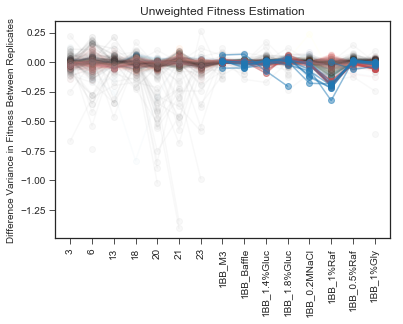

In [84]:
variance_difference = np.sqrt(unweighted_variance)-np.sqrt(weighted_variance)

condition_indices = list(range(12))+list(range(14,17))

for bc in range(variance_difference.shape[1]):
    if data['barcode'].values[bc] > 9000100:
        plt.plot(variance_difference[condition_indices,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
    elif data['barcode'].values[bc] > 9000000:
        plt.plot(variance_difference[condition_indices,bc],'o-',color='r',alpha=0.5)
    else:
        plt.plot(variance_difference[condition_indices,bc],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
plt.xticks(range(len(condition_indices)),[list(conditions.keys())[i] for i in condition_indices],rotation=90)
plt.title('Unweighted Fitness Estimation')
plt.ylabel('Difference Variance in Fitness Between Replicates')
# plt.ylim(-0.01,0.01)
# plt.yscale('symlog',linthresh = 0.0000001)



In [89]:
neg = sum(1 for i in tools.flatten(variance_difference) if i < 0)/len(tools.flatten(variance_difference))
pos = sum(1 for i in tools.flatten(variance_difference) if i > 0)/len(tools.flatten(variance_difference))
print(neg/(neg+pos))

0.5459706452506231


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/matplotlib/scale.py:114: RuntimeWarning: invalid value encountered in less_equal
  out[a <= 0] = -1000


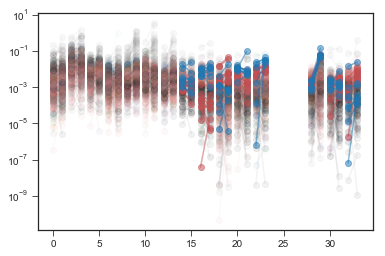

In [44]:
# unweighted_variance = np.asarray(bc_variances)
for bc in range(unweighted_variance.shape[1]):
    these_y = zip(unweighted_variance[:,bc],weighted_variance[:,bc])
#     these_y = tools.flatten(these_y)
#     these_x = [2*c,2*c+1]
    for e,entry in enumerate(these_y):
        if data['barcode'].values[bc] > 9000100:
            plt.plot([2*e,2*e+1],entry,'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
        elif data['barcode'].values[bc] > 9000000:
            plt.plot([2*e,2*e+1],entry,'o-',color='r',alpha=0.5)
        else:
            plt.plot([2*e,2*e+1],entry,'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
        
plt.yscale('log')
# plt.xticks(range(2*len(conditions)),[conditions])
    

In [31]:
# unweighted_variance = np.asarray(bc_variances)
for c,condition in enumerate(conditions):
    for bc in range(unweighted_variance.shape[1]):
        these_y = [unweighted_variance[:,bc],weighted_variance[:,bc]]
        these_x = [2*c,2*c+1]
        if data['barcode'].values[bc] > 9000100:
            plt.plot(these_x,these_y,'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
        elif data['barcode'].values[bc] > 9000000:
            plt.plot(these_x,these_y,'o-',color='r',alpha=0.5)
        else:
            plt.plot(these_x,these_y,'o-',color=mutant_colorset[genes[bc]],alpha=0.05)

# plt.yscale('log')
# plt.xticks(range(2*len(conditions)),[conditions])
    

KeyboardInterrupt: 

Error in callback <function install_repl_displayhook.<locals>.post_execute at 0x113be3510> (for post_execute):


ValueError: object too deep for desired array

ValueError: object too deep for desired array

<Figure size 432x288 with 1 Axes>

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:33: RuntimeWarning: Degrees of freedom <= 0 for slice.


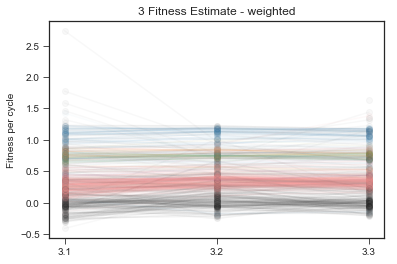

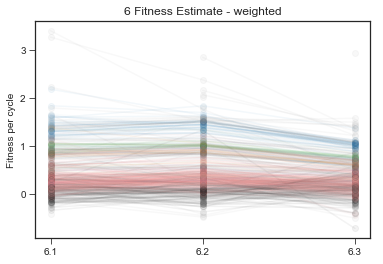

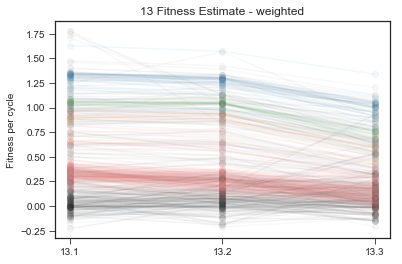

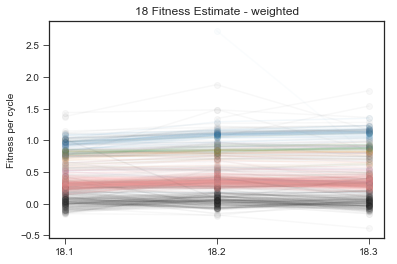

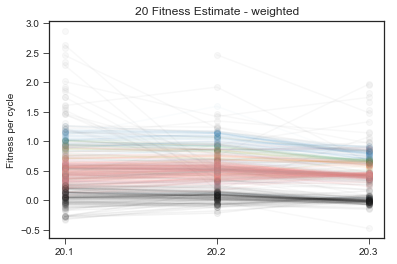

...

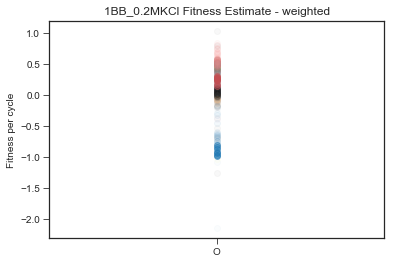

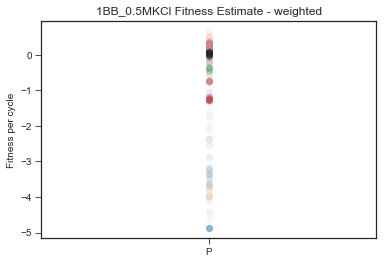

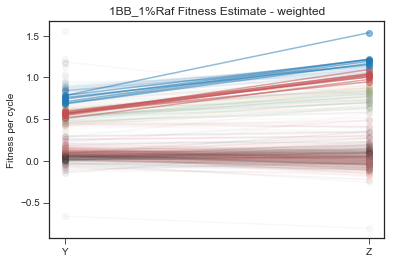

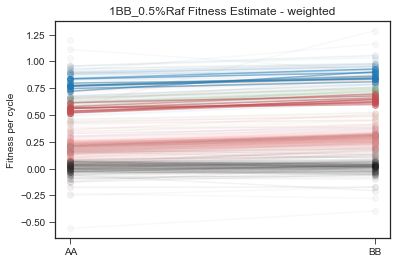

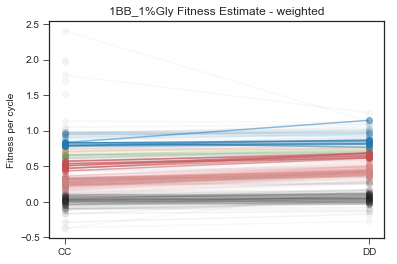

In [28]:
this_fitness = fitness_df_weighted

genes = this_fitness['gene'].values
bc_variances = []
for c,condition in enumerate(conditions):
# for condition in ['1BB_M3']:
    bc_variances.append([])
    plt.figure()
    if condition in bigbatch_conditions:
        reps = bigbatch_conditions[condition]
    else:
        reps = old_conditions[condition]
    
    
    these_rep_fitness = this_fitness[[rep+'_fitness' for rep in reps]].values
    
#     for t in range(fitnesses[reps[0]].shape[1]):
#         these_t_reps = np.asarray([fitnesses[rep][:,t] for rep in reps])
#         these_t_reps = these_t_reps.swapaxes(0,1)

#         these_times = [len(reps)*t + r for r in range(len(reps))] 
#         time_places = time_places + these_times
#         time_names = time_names + [f'{rep}\n{t}' for rep in reps] 
    for bc in range(these_rep_fitness.shape[0]):
        if data['barcode'].values[bc] > 9000100:
            plt.plot(range(len(reps)),these_rep_fitness[bc,:],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
        elif data['barcode'].values[bc] > 9000000:
            plt.plot(range(len(reps)),these_rep_fitness[bc,:],'o-',color='r',alpha=0.5)
        else:
            plt.plot(range(len(reps)),these_rep_fitness[bc,:],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
#         if t != fitnesses[reps[0]].shape[1]-1:
#             plt.axvline(x=len(reps)*(t+1)-0.5,color='k') 
        bc_variances[c].append(np.nanvar(these_rep_fitness[bc,:]))
    plt.title(f'{condition} Fitness Estimate - weighted')
    plt.ylabel('Fitness per cycle')
    plt.xticks(range(len(reps)),reps)
    plt.savefig(f'fitness_plots_{condition}_weighted.pdf',bbox_inches='tight')    
weighted_variance = np.asarray(bc_variances)     

In [93]:
fitness_df_weighted

,barcode,gene,type,ploidy,class,additional_muts,13.1_error,13.1_fitness,13.2_error,13.2_fitness,...,1BB_0.2MKCl_fitness,1BB_0.2MKCl_error,1BB_0.5MKCl_fitness,1BB_0.5MKCl_error,1BB_1%Raf_fitness,1BB_1%Raf_error,1BB_0.5%Raf_fitness,1BB_0.5%Raf_error,1BB_1%Gly_fitness,1BB_1%Gly_error
0,53,Diploid,Diploid,Diploid,Diploid,TIP1-upstream_point_variant; YKR012C-upstream_...,0.086877,0.366047,0.083404,0.315150,...,0.517133,0.054619,0.281774,0.059401,0.082724,0.060322,0.267503,0.024743,0.351641,0.031392
1,151,IRA1,stop_gained,Haploid,PKA,"MIM1,tS-upstream_indel_variant; SEH1-missense_...",0.059241,1.628226,0.059251,1.570717,...,0.252553,0.050905,-2.547008,0.103433,0.990029,0.050504,1.004842,0.017600,1.018480,0.024649
2,262,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.069475,0.196277,0.068634,0.105044,...,0.562643,0.055950,0.301131,0.061419,0.138540,0.063584,0.288765,0.025901,0.358404,0.032418
3,273,IRA1,frameshift_variant,Haploid,PKA,None,0.059303,1.133521,0.059304,1.206520,...,0.425995,0.051479,-1.036554,0.081520,0.733651,0.050832,0.778585,0.017914,0.787411,0.025075
4,323,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.059382,1.113742,0.059383,1.101149,...,0.421169,0.052638,-0.430072,0.070879,0.701008,0.051590,0.647284,0.018741,0.664027,0.025911
5,415,IRA1,frameshift_variant,Haploid,PKA,None,0.060026,1.328568,0.059880,1.330132,...,-0.290556,0.062332,-3.652083,0.218403,0.969724,0.050702,0.889023,0.017789,0.967308,0.025020
6,499,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.060481,1.198759,0.060173,1.177681,...,NaN,inf,NaN,inf,0.000000,4.176465,NaN,inf,NaN,inf
7,622,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.167772,0.403564,0.238859,0.147452,...,0.507302,0.056559,0.260380,0.062638,-0.028748,0.066156,0.188938,0.027013,0.310583,0.034162
8,689,IRA1,frameshift_variant,Haploid,PKA,RPL19A-upstream_point_variant,0.059639,1.351715,0.059628,1.287908,...,-0.616392,0.096871,-3.315940,0.496535,0.987435,0.051392,0.994024,0.018229,1.068526,0.025928
9,697,NotSequenced,NotSequenced,NotSequenced,NotSequenced,NotSequenced,0.079211,0.292709,0.078981,0.195564,...,0.468017,0.056099,0.301192,0.061008,0.091431,0.063976,0.216814,0.026500,0.306125,0.033305


In [10]:
data = merged_data
data = data[~(data['barcode'].isin([7777777,9999999]))]
data = data.sort_values('barcode')
data = data.drop(columns=['L2','6-1-3','6-2-2']) # sparse timepoints resulting a lot of missing data

cov_thresh = 100

### called neutral by atish's method in ALL 5000 bc experiments (I think - need to verify this)
### [could also be below some set threshold across all experiments]
full_neutral_list = [17615,18486,42040,45014,58284,63611,73731,74185,80465,94896
,120600,125697,132511,134852,135750,190551,228237,238783,255561,298344
,308537,316954,317346,335717,411685,454359,469053] 

### from previous list but never has fitness above 3.5% (per gen) in any of 5000bc experiments
supergood_neutral = [17615, 24362, 42040, 71926, 72939, 73802, 80465, 109476, 113483, 
                     134852, 135750, 238783, 263665, 276406, 316954, 335717, 454359] 

### pulled from supergood list and spiked into 1BigBatch experiments
neutral_spikes = [17615,24362,42040,71926,73802,109476,113483,134852,263665,316954]

# neutrals = full_neutral_list
neutrals = list(np.unique(full_neutral_list+supergood_neutral+neutral_spikes))

neutrals = [bc for bc in data['barcode'].values if bc in neutrals]
# neutrals = neutral_spikes
print(neutrals)

downsample_target = 1e6

fitnesses = {}

other_info = ['barcode','gene','type','ploidy','class','additional_muts']

for condition,replicates in conditions.items():
    print(condition)
    print(replicates)
    rep_times = {}
    for rep in replicates:
        
        these_times = []
        timepoints = []
        if condition in old_conditions.keys():
            
            e,r = rep.split('.')
#             if e in ['13','15']:
#                 timepoints.append(0)
#                 these_times.append('13-0_pool')
#             else:
#                 if e+'-0' in data.columns:
#                     timepoints.append(0)
#                     these_times.append(e+'-0')
            for t in range(1,5):
                if e+'-'+str(t)+'-'+r in data.columns:
                    timepoints.append(t)
                    these_times.append(e+'-'+str(t)+'-'+r)

        if condition in bigbatch_conditions.keys():
            for i in range(5):
                if rep+str(i) in data.columns:
                    these_times.append(rep+str(i))
                    timepoints.append(i)
#         rep_times[rep] = data[these_times].values
        rep_times[rep] = tools.downsample_single(data[these_times].values,downsample_target)
        print(timepoints)
        print(rep)
    answer = atish.inferFitness(data['barcode'].values,timepoints,rep_times,
                                neutralBarcodes=neutrals,lowCoverageThresh=cov_thresh,use_all_neutral=True,useMultNoise=True,weightedMean=True)


    for rep in replicates:

        fitnesses[rep+'_fitness'] = answer[rep]['aveFitness']
        fitnesses[rep+'_error'] = answer[rep]['aveError']

for other_setting in other_info:
    if other_setting in data.columns:
        fitnesses[other_setting] = data[other_setting].values

fitness_df = p.DataFrame(fitnesses)
fitness_df = fitness_df.replace([np.inf, -np.inf], np.nan)
# fitness_df = fitness_df.replace([float('Inf'),-float('Inf'),np.inf, -np.inf], np.nan)

for condition,replicates in conditions.items():
    
    
    fitness_df[condition+'_fitness'] = np.nansum([fitness_df[rep+'_fitness'].values/fitness_df[rep+'_error'].values for rep in replicates],axis=0) \
    /np.nansum([1.0/fitness_df[rep+'_error'].values for rep in replicates],axis=0)
    
    fitness_df[condition+'_error'] = np.nansum([1.0/fitness_df[rep+'_error'].values for rep in replicates],axis=0)**(-1)


    
fitness_df_weighted_downsample = fitness_df[other_info+[col for col in fitness_df if col not in other_info]]
# fitness_df.to_csv('../data/DoubleBC_Merged_Fitness_Atish_Default_AllConditions.csv',index=False)


[17615, 24362, 42040, 71926, 72939, 73802, 109476, 113483, 120600, 134852, 263665, 298344, 316954]
3
['3.1', '3.2', '3.3']
[1, 2, 3, 4]
3.1
[1, 2, 3, 4]
3.2
[1, 2, 3, 4]
3.3
neutral reads 2150.0 781.0
neutral reads 781.0 396.0
neutral reads 396.0 108.0
neutral reads 2150.0 781.0
neutral reads 781.0 396.0
neutral reads 396.0 108.0
neutral reads 1999.0 581.0
neutral reads 581.0 237.0
neutral reads 237.0 88.0
neutral reads 1999.0 581.0
neutral reads 581.0 237.0
neutral reads 237.0 88.0
neutral reads 2628.0 977.0
neutral reads 977.0 314.0
neutral reads 314.0 129.0
neutral reads 2528.0 945.0
neutral reads 945.0 288.0
neutral reads 288.0 118.0
Multiplicative noise consistency checks

3.1  inconsistent times:

kappas [0.9592777 3.8029358 1.3711588]
multNoise [0.11409212 0.11506193 0.09562289]
No clear inconsistencies


3.2  inconsistent times:

kappas [3.00907536 3.27581939 3.00991952]
multNoise [0.11409212 0.11506193 0.09562289]
No clear inconsistencies


3.3  inconsistent times:

kappas [1.

/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:219: RuntimeWarning: divide by zero encountered in power
  zScores = zScores*np.power(expectedReads,-0.5)
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:219: RuntimeWarning: invalid value encountered in multiply
  zScores = zScores*np.power(expectedReads,-0.5)
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:386: RuntimeWarning: divide by zero encountered in log
  allTimeFitness = np.log(allReads[repName][:,1:]/totReads[1:])-np.log(allReads[repName][:,0:-1]/totReads[0:-1])
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_assay_grantedits.py:386: RuntimeWarning: invalid value encountered in subtract
  allTimeFitness = np.log(allReads[repName][:,1:]/totReads[1:])-np.log(allReads[repName][:,0:-1]/totReads[0:-1])
/Users/grantkinsler/Documents/Stanford/Research/TheoryPaper/code/fitness_a

[1, 2, 3, 4]
23.3
neutral reads 3364.0 1758.0
neutral reads 1758.0 644.0
neutral reads 644.0 337.0
neutral reads 3364.0 1758.0
neutral reads 1758.0 644.0
neutral reads 644.0 337.0
neutral reads 3521.0 1825.0
neutral reads 1825.0 895.0
neutral reads 895.0 424.0
neutral reads 3521.0 1824.0
neutral reads 1824.0 895.0
neutral reads 895.0 424.0
neutral reads 3920.0 2059.0
neutral reads 2059.0 1179.0
neutral reads 1179.0 499.0
neutral reads 3920.0 2059.0
neutral reads 2059.0 1179.0
neutral reads 1179.0 499.0
Multiplicative noise consistency checks

23.1  inconsistent times:

kappas [ 4.72672485  5.09257895 11.46861135]
multNoise [0.11025244 0.23609155 0.1968049 ]
No clear inconsistencies


23.2  inconsistent times:

kappas [6.32389463 2.02399246 0.68966361]
multNoise [0.11025244 0.23609155 0.1968049 ]
No clear inconsistencies


23.3  inconsistent times:

kappas [2.75187069 1.0864976  0.39709821]
multNoise [0.11025244 0.23609155 0.1968049 ]
No clear inconsistencies

1BB_M3
['A', 'B', 'C', 'D'

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:86: RuntimeWarning: invalid value encountered in true_divide
/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:88: RuntimeWarning: divide by zero encountered in reciprocal


/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/ipykernel_launcher.py:33: RuntimeWarning: Degrees of freedom <= 0 for slice.


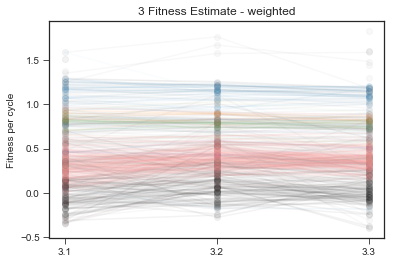

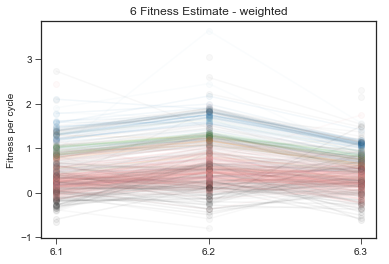

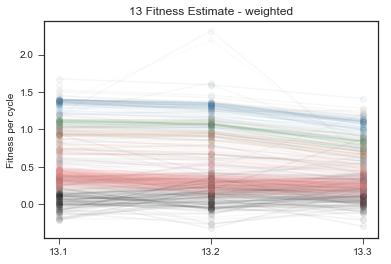

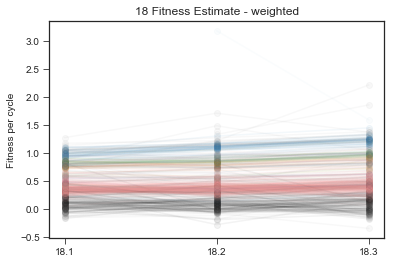

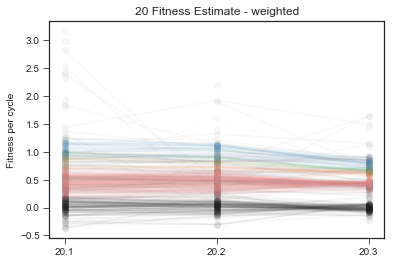

...

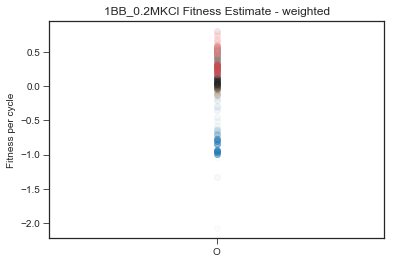

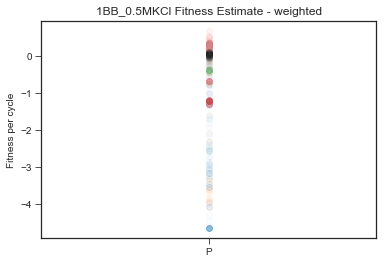

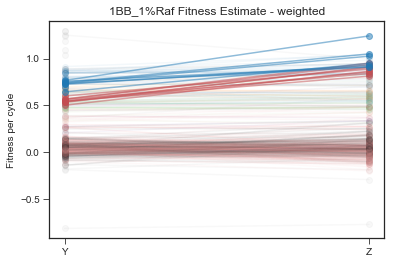

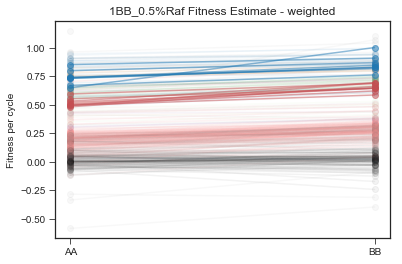

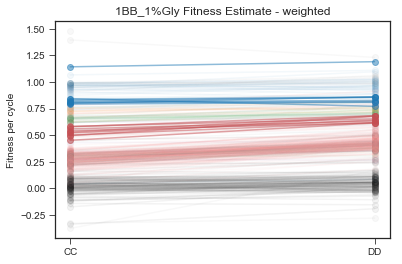

In [11]:
this_fitness = fitness_df_weighted_downsample

genes = this_fitness['gene'].values
bc_variances = []
for c,condition in enumerate(conditions):
# for condition in ['1BB_M3']:
    bc_variances.append([])
    plt.figure()
    if condition in bigbatch_conditions:
        reps = bigbatch_conditions[condition]
    else:
        reps = old_conditions[condition]
    
    
    these_rep_fitness = this_fitness[[rep+'_fitness' for rep in reps]].values
    
#     for t in range(fitnesses[reps[0]].shape[1]):
#         these_t_reps = np.asarray([fitnesses[rep][:,t] for rep in reps])
#         these_t_reps = these_t_reps.swapaxes(0,1)

#         these_times = [len(reps)*t + r for r in range(len(reps))] 
#         time_places = time_places + these_times
#         time_names = time_names + [f'{rep}\n{t}' for rep in reps] 
    for bc in range(these_rep_fitness.shape[0]):
        if data['barcode'].values[bc] > 9000100:
            plt.plot(range(len(reps)),these_rep_fitness[bc,:],'o-',color=mutant_colorset[genes[bc]],alpha=0.5)
        elif data['barcode'].values[bc] > 9000000:
            plt.plot(range(len(reps)),these_rep_fitness[bc,:],'o-',color='r',alpha=0.5)
        else:
            plt.plot(range(len(reps)),these_rep_fitness[bc,:],'o-',color=mutant_colorset[genes[bc]],alpha=0.05)
#         if t != fitnesses[reps[0]].shape[1]-1:
#             plt.axvline(x=len(reps)*(t+1)-0.5,color='k') 
        bc_variances[c].append(np.nanvar(these_rep_fitness[bc,:]))
    plt.title(f'{condition} Fitness Estimate - weighted')
    plt.ylabel('Fitness per cycle')
    plt.xticks(range(len(reps)),reps)
    plt.savefig(f'fitness_plots_{condition}_weighted_downsample{downsample_target}.pdf',bbox_inches='tight')    
# weighted_variance = np.asarray(bc_variances)     

(-0.4, 1.6)

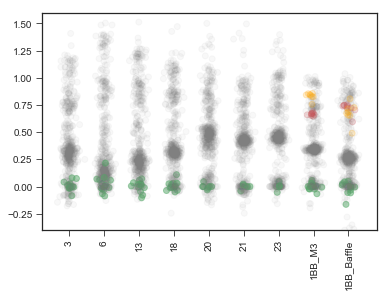

In [105]:
data = merged_data
data = data[~(merged_data['barcode'].isin([7777777,9999999]))]
data = data.sort_values('barcode')

spike_in_missense = [9000000 + i for i in range(11)]
spike_in_nonsense = [9000100 + i for i in range(11)]
neutrals = list(np.unique(full_neutral_list+supergood_neutral+neutral_spikes))

neutrals = [bc for bc in data['barcode'].values if bc in neutrals]
# neutrals = [17615,24362,42040,71926,73802,109476,113483,134852,263665,316954]
neutral_locs = np.where(np.isin(data['barcode'].values,neutrals))[0]
color_set = []
alphas = []
for bc in data['barcode'].values:
#     print(bc)
    if bc in spike_in_missense:
        color_set.append(colors.to_rgba('r',0.2))
    elif bc in spike_in_nonsense:
        color_set.append(colors.to_rgba('orange',0.2))
    elif bc in neutrals:
        color_set.append(colors.to_rgba('g',0.5))
    elif bc == 9999999:
        color_set.append(colors.to_rgba('k',0.5))
    else:
        color_set.append(colors.to_rgba('gray',0.05))



for j,condition in enumerate(conditions.keys()):
    plt.scatter([jitter_point(j,0.1) for  i in range(len(fitness_df[f'{condition}_fitness'].values))],fitness_df[f'{condition}_fitness'].values,color=color_set)

plt.xticks(range(len(conditions.keys())),conditions.keys(),rotation=90)
plt.ylim(-0.4,1.6)
# plt.savefig('AllM3_conditions_fitness_allTPs.png',bbox_inches='tight',dpi=300)